# Proyecto - Host Airbnb

Nombre: Gustavo Blas Duran

### Librerias y opciones de formato

In [3]:
import warnings
warnings.filterwarnings('ignore')

In [4]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import ks_2samp
from functools import reduce
from varclushi import VarClusHi

In [5]:
pd.set_option('display.max_columns', 200)
pd.set_option('display.max_rows',200)
pd.options.display.float_format = '{:,.2f}'.format

In [7]:
from scratch.churn_mod_func import *

### Problematica

Armar la TAD para poder determinar la disponibilidad en una determinada fecha.
Host mas ocupados.

No se tiene un historial por HOST para determinar la disponibilidad en cierta fecha, pero se puede determinar la disponibilidad del HOST. (clasificacion)
Determinar el precio del HOST. (regresion)

## Lectura de Datos

Se proporciona un archivo `csv`. [source](https://www.kaggle.com/datasets/arianazmoudeh/airbnbopendata/data)

In [8]:
file = '../data/Airbnb/Airbnb_Open_Data.csv'
airbnb = pd.read_csv(file)
print("Numero de registros: ", airbnb.shape[0])
print("Numero de columnas: ", airbnb.shape[1])

Numero de registros:  102599
Numero de columnas:  26


In [9]:
airbnb.head(3)

,id,NAME,host id,host_identity_verified,host name,neighbourhood group,neighbourhood,lat,long,country,country code,instant_bookable,cancellation_policy,room type,Construction year,price,service fee,minimum nights,number of reviews,last review,reviews per month,review rate number,calculated host listings count,availability 365,house_rules,license
0,1001254,Clean & quiet apt home by the park,80014485718,unconfirmed,Madaline,Brooklyn,Kensington,40.65,-73.97,United States,US,False,strict,Private room,"2,020.00",$966,$193,10.00,9.00,10/19/2021,0.21,4.00,6.00,286.00,Clean up and treat the home the way you'd like...,NaN
1,1002102,Skylit Midtown Castle,52335172823,verified,Jenna,Manhattan,Midtown,40.75,-73.98,United States,US,False,moderate,Entire home/apt,"2,007.00",$142,$28,30.00,45.00,5/21/2022,0.38,4.00,2.00,228.00,Pet friendly but please confirm with me if the...,NaN
2,1002403,THE VILLAGE OF HARLEM....NEW YORK !,78829239556,NaN,Elise,Manhattan,Harlem,40.81,-73.94,United States,US,True,flexible,Private room,"2,005.00",$620,$124,3.00,0.00,NaN,NaN,5.00,1.00,352.00,"I encourage you to use my kitchen, cooking and...",NaN


In [10]:
airbnb.columns = airbnb.columns.str.replace(' ', '_').str.upper()
airbnb.columns

Index(['ID', 'NAME', 'HOST_ID', 'HOST_IDENTITY_VERIFIED', 'HOST_NAME',
       'NEIGHBOURHOOD_GROUP', 'NEIGHBOURHOOD', 'LAT', 'LONG', 'COUNTRY',
       'COUNTRY_CODE', 'INSTANT_BOOKABLE', 'CANCELLATION_POLICY', 'ROOM_TYPE',
       'CONSTRUCTION_YEAR', 'PRICE', 'SERVICE_FEE', 'MINIMUM_NIGHTS',
       'NUMBER_OF_REVIEWS', 'LAST_REVIEW', 'REVIEWS_PER_MONTH',
       'REVIEW_RATE_NUMBER', 'CALCULATED_HOST_LISTINGS_COUNT',
       'AVAILABILITY_365', 'HOUSE_RULES', 'LICENSE'],
      dtype='object')

__Descripción de dataset__

* __ID__: identificador unico del listado
* __NAME__: nombre del listado
* __HOST_ID__: identificador unico en Airbnb 
* __HOST_IDENTITY_VERIFIED__:
* __HOST_NAME__: nombre del host, usualmente el primer nombre
* __NEIGHBOURHOOD_GROUP__: 
* __LAT__: valor de ubicación (latitud)
* __LONG__: valor de ubicación (longitud)
* __COUNTRY_CODE__: codigo del pais
* __INSTANT_BOOKABLE__: Indica si el huesped puede reservar automaticamente el alojamiento sin que el anfitrión tenga que aceptar su solicitud. Indica que el alojamiento es comercial.
* __CANCELLATION_POLICY__: 
* __ROOM_TYPE__: clasificacion del tipo de cuarto del listado
* __CONSTRUCTION_YEAR__:
* __PRICE__: precio diario en moneda local
* __SERVICE_FEE__: tarifa de servicio
* __MINIMUM_NIGHTS__: numero de noches minimas para el listado
* __NUMBER_OF_REVIEWS__: número de reseñas que tiene el anuncio
* __LAST_REVIEW__: fecha de la ultima mas reciente revisión
* __REVIEWS_PER_MONTH__: la cantidad de reseñas que tiene el anuncio a lo largo de su existencia
* __REVIEW_RATE_NUMBER__:
* __CALCULATED_HOST_LISTINGS_COUNT__: cantidad de listados que tiene el anfitrión en el rastreo actual, en la geografía de la ciudad/region.
* __AVAILABILITY_365__: la disponibilidad del alojamiento dentro de x dias, segun el calendario. 
    Tenga en cuenta que un alojamiento podria no estar disponible porque ya ha sido reservado por un huesped o bloqueado por el anfitrión.
* __HOUSE_RULES__: comentarios adicionales acerca del reglamento del sitio.
* __LICENCE__:

In [11]:
airbnb.head(10)

,ID,NAME,HOST_ID,HOST_IDENTITY_VERIFIED,HOST_NAME,NEIGHBOURHOOD_GROUP,NEIGHBOURHOOD,LAT,LONG,COUNTRY,COUNTRY_CODE,INSTANT_BOOKABLE,CANCELLATION_POLICY,ROOM_TYPE,CONSTRUCTION_YEAR,PRICE,SERVICE_FEE,MINIMUM_NIGHTS,NUMBER_OF_REVIEWS,LAST_REVIEW,REVIEWS_PER_MONTH,REVIEW_RATE_NUMBER,CALCULATED_HOST_LISTINGS_COUNT,AVAILABILITY_365,HOUSE_RULES,LICENSE
0,1001254,Clean & quiet apt home by the park,80014485718,unconfirmed,Madaline,Brooklyn,Kensington,40.65,-73.97,United States,US,False,strict,Private room,"2,020.00",$966,$193,10.00,9.00,10/19/2021,0.21,4.00,6.00,286.00,Clean up and treat the home the way you'd like...,NaN
1,1002102,Skylit Midtown Castle,52335172823,verified,Jenna,Manhattan,Midtown,40.75,-73.98,United States,US,False,moderate,Entire home/apt,"2,007.00",$142,$28,30.00,45.00,5/21/2022,0.38,4.00,2.00,228.00,Pet friendly but please confirm with me if the...,NaN
2,1002403,THE VILLAGE OF HARLEM....NEW YORK !,78829239556,NaN,Elise,Manhattan,Harlem,40.81,-73.94,United States,US,True,flexible,Private room,"2,005.00",$620,$124,3.00,0.00,NaN,NaN,5.00,1.00,352.00,"I encourage you to use my kitchen, cooking and...",NaN
3,1002755,NaN,85098326012,unconfirmed,Garry,Brooklyn,Clinton Hill,40.69,-73.96,United States,US,True,moderate,Entire home/apt,"2,005.00",$368,$74,30.00,270.00,7/5/2019,4.64,4.00,1.00,322.00,NaN,NaN
4,1003689,Entire Apt: Spacious Studio/Loft by central park,92037596077,verified,Lyndon,Manhattan,East Harlem,40.80,-73.94,United States,US,False,moderate,Entire home/apt,"2,009.00",$204,$41,10.00,9.00,11/19/2018,0.10,3.00,1.00,289.00,"Please no smoking in the house, porch or on th...",NaN
5,1004098,Large Cozy 1 BR Apartment In Midtown East,45498551794,verified,Michelle,Manhattan,Murray Hill,40.75,-73.97,United States,US,True,flexible,Entire home/apt,"2,013.00",$577,$115,3.00,74.00,6/22/2019,0.59,3.00,1.00,374.00,"No smoking, please, and no drugs.",NaN
6,1004650,BlissArtsSpace!,61300605564,NaN,Alberta,Brooklyn,Bedford-Stuyvesant,40.69,-73.96,United States,US,False,moderate,Private room,"2,015.00",$71,$14,45.00,49.00,10/5/2017,0.40,5.00,1.00,224.00,Please no shoes in the house so bring slippers...,NaN
7,1005202,BlissArtsSpace!,90821839709,unconfirmed,Emma,Brooklyn,Bedford-Stuyvesant,40.69,-73.96,United States,US,False,moderate,Private room,"2,009.00","$1,060",$212,45.00,49.00,10/5/2017,0.40,5.00,1.00,219.00,House Guidelines for our BnB We are delighted ...,NaN
8,1005754,Large Furnished Room Near B'way,79384379533,verified,Evelyn,Manhattan,Hell's Kitchen,40.76,-73.98,United States,US,True,strict,Private room,"2,005.00","$1,018",$204,2.00,430.00,6/24/2019,3.47,3.00,1.00,180.00,- Please clean up after yourself when using th...,NaN
9,1006307,Cozy Clean Guest Room - Family Apt,75527839483,unconfirmed,Carl,Manhattan,Upper West Side,40.80,-73.97,United States,US,False,strict,Private room,"2,015.00",$291,$58,2.00,118.00,7/21/2017,0.99,5.00,1.00,375.00,NO SMOKING OR PETS ANYWHERE ON THE PROPERTY 1....,NaN


## Variables

Tenemos las siguientes variables en el conjunto de datos

In [12]:
pd.DataFrame(airbnb.dtypes).sort_values(by=0)

,0
ID,int64
HOST_ID,int64
AVAILABILITY_365,float64
CALCULATED_HOST_LISTINGS_COUNT,float64
REVIEW_RATE_NUMBER,float64
REVIEWS_PER_MONTH,float64
LAT,float64
LONG,float64
NUMBER_OF_REVIEWS,float64
MINIMUM_NIGHTS,float64


In [13]:
airbnb.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 102599 entries, 0 to 102598
Data columns (total 26 columns):
 #   Column                          Non-Null Count   Dtype  
---  ------                          --------------   -----  
 0   ID                              102599 non-null  int64  
 1   NAME                            102349 non-null  object 
 2   HOST_ID                         102599 non-null  int64  
 3   HOST_IDENTITY_VERIFIED          102310 non-null  object 
 4   HOST_NAME                       102193 non-null  object 
 5   NEIGHBOURHOOD_GROUP             102570 non-null  object 
 6   NEIGHBOURHOOD                   102583 non-null  object 
 7   LAT                             102591 non-null  float64
 8   LONG                            102591 non-null  float64
 9   COUNTRY                         102067 non-null  object 
 10  COUNTRY_CODE                    102468 non-null  object 
 11  INSTANT_BOOKABLE                102494 non-null  object 
 12  CANCELLATION_POL

Agregamos la variable (Columna) `licence` y `house_rules` a el listado de las variables descartadas, ya que tienen mas del 50% de datos en valores con `nan`.

In [14]:
# Porcentaje de valores faltantes por columna en porcentaje
airbnb.isnull().sum() / airbnb.shape[0] * 100

ID                                 0.00
NAME                               0.24
HOST_ID                            0.00
HOST_IDENTITY_VERIFIED             0.28
HOST_NAME                          0.40
NEIGHBOURHOOD_GROUP                0.03
NEIGHBOURHOOD                      0.02
LAT                                0.01
LONG                               0.01
COUNTRY                            0.52
COUNTRY_CODE                       0.13
INSTANT_BOOKABLE                   0.10
CANCELLATION_POLICY                0.07
ROOM_TYPE                          0.00
CONSTRUCTION_YEAR                  0.21
PRICE                              0.24
SERVICE_FEE                        0.27
MINIMUM_NIGHTS                     0.40
NUMBER_OF_REVIEWS                  0.18
LAST_REVIEW                       15.49
REVIEWS_PER_MONTH                 15.48
REVIEW_RATE_NUMBER                 0.32
CALCULATED_HOST_LISTINGS_COUNT     0.31
AVAILABILITY_365                   0.44
HOUSE_RULES                       50.81


Porcentaje total de valores faltantes en todo el conjunto de datos

In [15]:
# Porcentaje de valores faltantes el el dataset
print( "Porcentaje de valores faltantes en el dataset" , round(float(airbnb.isnull().sum().sum() / np.prod(airbnb.shape) * 100),3))

Porcentaje de valores faltantes en el dataset 7.151


Se considera a la variable `id` como la __unidad muestral__, ya que es el identificador unico de cada registro.

In [16]:
airbnb[airbnb['ID'].isnull()]

,ID,NAME,HOST_ID,HOST_IDENTITY_VERIFIED,HOST_NAME,NEIGHBOURHOOD_GROUP,NEIGHBOURHOOD,LAT,LONG,COUNTRY,COUNTRY_CODE,INSTANT_BOOKABLE,CANCELLATION_POLICY,ROOM_TYPE,CONSTRUCTION_YEAR,PRICE,SERVICE_FEE,MINIMUM_NIGHTS,NUMBER_OF_REVIEWS,LAST_REVIEW,REVIEWS_PER_MONTH,REVIEW_RATE_NUMBER,CALCULATED_HOST_LISTINGS_COUNT,AVAILABILITY_365,HOUSE_RULES,LICENSE


Existen registros en `id` con valores duplicados

In [17]:
airbnb['ID'].value_counts()

ID
6044940     2
6067584     2
6077525     2
6076973     2
6076421     2
           ..
19804390    1
19803837    1
19803285    1
19802733    1
57367417    1
Name: count, Length: 102058, dtype: int64

Eliminamos valores duplicados, los registros completos que tienen los mismos valores

In [18]:
aux_dup = pd.DataFrame(airbnb['ID'].value_counts()).reset_index()
aux_dup = aux_dup[aux_dup['count'] > 1].sort_values(by='count', ascending=False)
aux_dup

,ID,count
0,6044940,2
356,20357794,2
370,20331836,2
369,20332388,2
368,20332941,2
...,...,...
175,35582496,2
174,35581944,2
173,35581391,2
172,35580839,2


In [19]:
airbnb[airbnb['ID'].isin(aux_dup['ID'])].sort_values(by='ID').head(6)

,ID,NAME,HOST_ID,HOST_IDENTITY_VERIFIED,HOST_NAME,NEIGHBOURHOOD_GROUP,NEIGHBOURHOOD,LAT,LONG,COUNTRY,COUNTRY_CODE,INSTANT_BOOKABLE,CANCELLATION_POLICY,ROOM_TYPE,CONSTRUCTION_YEAR,PRICE,SERVICE_FEE,MINIMUM_NIGHTS,NUMBER_OF_REVIEWS,LAST_REVIEW,REVIEWS_PER_MONTH,REVIEW_RATE_NUMBER,CALCULATED_HOST_LISTINGS_COUNT,AVAILABILITY_365,HOUSE_RULES,LICENSE
9098,6026161,Upper East Side 2 bedroom- close to Hospitals-,65193709566,verified,Juliana,Manhattan,Upper East Side,40.76,-73.96,United States,US,False,moderate,Entire home/apt,"2,008.00",$105,$21,30.00,2.00,6/8/2019,0.21,3.00,34.00,157.00,NaN,NaN
102474,6026161,Upper East Side 2 bedroom- close to Hospitals-,65193709566,verified,Juliana,Manhattan,Upper East Side,40.76,-73.96,United States,US,False,moderate,Entire home/apt,"2,008.00",$105,$21,30.00,2.00,6/8/2019,0.21,3.00,34.00,157.00,NaN,NaN
102475,6026714,Close to East Side Hospitals- Modern 2 Bedroom...,31072202372,verified,Juliana,Manhattan,Upper East Side,40.76,-73.96,United States,US,False,moderate,Entire home/apt,"2,008.00",$285,$57,30.00,6.00,1/31/2019,0.14,3.00,34.00,67.00,"The quieter the better, but otherwise make you...",NaN
9099,6026714,Close to East Side Hospitals- Modern 2 Bedroom...,31072202372,verified,Juliana,Manhattan,Upper East Side,40.76,-73.96,United States,US,False,moderate,Entire home/apt,"2,008.00",$285,$57,30.00,6.00,1/31/2019,0.14,3.00,34.00,67.00,"The quieter the better, but otherwise make you...",NaN
9100,6027266,ACADIA Spacious 2 Bedroom Apt - Close to Hospi...,95854111798,verified,Juliana,Manhattan,Upper East Side,40.76,-73.96,United States,US,False,moderate,Entire home/apt,"2,014.00",$586,$117,30.00,10.00,11/18/2018,0.22,5.00,34.00,211.00,No Smoking No Pets,NaN
102476,6027266,ACADIA Spacious 2 Bedroom Apt - Close to Hospi...,95854111798,verified,Juliana,Manhattan,Upper East Side,40.76,-73.96,United States,US,False,moderate,Entire home/apt,"2,014.00",$586,$117,30.00,10.00,11/18/2018,0.22,5.00,34.00,211.00,No Smoking No Pets,NaN


Se eliminan los registros duplicados del conjunto de datos, ahora solo tenemos a la variable `id` como nuestra unidad muestral.

In [20]:
# Eliminar duplicados
print("Numero de registros: (antes de drop_duplicates)", airbnb.shape[0])
airbnb = airbnb.drop_duplicates(subset='ID', keep='first')
print("Numero de registros: (despues de drop_duplicates)", airbnb.shape[0])

Numero de registros: (antes de drop_duplicates) 102599
Numero de registros: (despues de drop_duplicates) 102058


In [21]:
# Validacion de duplicados
airbnb['ID'].value_counts()

ID
1001254     1
38582590    1
38581485    1
38580933    1
38580380    1
           ..
19789477    1
19788925    1
19788373    1
19787821    1
57367417    1
Name: count, Length: 102058, dtype: int64

Los valores de la columna `price` y `service fee` son de tipo `object`, en relidad deben ser datos numericos, pero el algunos datos contienen el caracter `$`, por lo que se hace el reemplazo de los caracteres.

In [22]:
airbnb['PRICE'].head()

0    $966 
1    $142 
2    $620 
3    $368 
4    $204 
Name: PRICE, dtype: object

In [23]:
airbnb['PRICE'] = airbnb['PRICE'].str.replace('$', '')
airbnb['PRICE'] = airbnb['PRICE'].str.replace(',', '')
airbnb['PRICE'] = airbnb['PRICE'].astype(float)

In [24]:
airbnb['PRICE'].describe(percentiles=np.linspace(0, 1, 11)) # Aquì ya no hay el simbolo de $ y la coma

count   101,811.00
mean        625.36
std         331.67
min          50.00
0%           50.00
10%         165.00
20%         281.00
30%         399.00
40%         511.00
50%         625.00
60%         738.00
70%         855.00
80%         971.00
90%       1,086.00
100%      1,200.00
max       1,200.00
Name: PRICE, dtype: float64

In [25]:
airbnb['SERVICE_FEE'] = airbnb['SERVICE_FEE'].str.replace('$', '')
airbnb['SERVICE_FEE'] = airbnb['SERVICE_FEE'].str.replace(',', '')
airbnb['SERVICE_FEE'] = airbnb['SERVICE_FEE'].astype(float)

In [26]:
airbnb['SERVICE_FEE'].describe(percentiles=np.linspace(0, 1, 11))

count   101,785.00
mean        125.04
std          66.33
min          10.00
0%           10.00
10%          33.00
20%          56.00
30%          80.00
40%         102.00
50%         125.00
60%         147.00
70%         171.00
80%         194.00
90%         217.00
100%        240.00
max         240.00
Name: SERVICE_FEE, dtype: float64

In [27]:
airbnb['CONSTRUCTION_YEAR'].head()

0   2,020.00
1   2,007.00
2   2,005.00
3   2,005.00
4   2,009.00
Name: CONSTRUCTION_YEAR, dtype: float64

Se realiza la transformación del tipo de dato `datetime` para la columna con fechas.

In [28]:
airbnb['LAST_REVIEW'].sample(10)

61066    12/17/2021
43846           NaN
16821     4/30/2019
11938           NaN
1766       1/6/2019
85404     6/25/2016
93611      5/8/2019
1300       5/5/2019
38988     6/22/2019
80407     6/24/2019
Name: LAST_REVIEW, dtype: object

In [29]:
airbnb['LAST_REVIEW'] = pd.to_datetime(airbnb['LAST_REVIEW'])
airbnb['LAST_REVIEW'].sample(10)

69465   2019-07-02
14682   2016-06-30
50039   2022-03-01
55721   2022-02-01
53781   2022-02-15
75643          NaT
54695   2022-02-12
58864   2022-01-02
96573   2019-04-28
17364   2016-10-24
Name: LAST_REVIEW, dtype: datetime64[ns]

In [30]:
airbnb.head()

,ID,NAME,HOST_ID,HOST_IDENTITY_VERIFIED,HOST_NAME,NEIGHBOURHOOD_GROUP,NEIGHBOURHOOD,LAT,LONG,COUNTRY,COUNTRY_CODE,INSTANT_BOOKABLE,CANCELLATION_POLICY,ROOM_TYPE,CONSTRUCTION_YEAR,PRICE,SERVICE_FEE,MINIMUM_NIGHTS,NUMBER_OF_REVIEWS,LAST_REVIEW,REVIEWS_PER_MONTH,REVIEW_RATE_NUMBER,CALCULATED_HOST_LISTINGS_COUNT,AVAILABILITY_365,HOUSE_RULES,LICENSE
0,1001254,Clean & quiet apt home by the park,80014485718,unconfirmed,Madaline,Brooklyn,Kensington,40.65,-73.97,United States,US,False,strict,Private room,"2,020.00",966.00,193.00,10.00,9.00,2021-10-19,0.21,4.00,6.00,286.00,Clean up and treat the home the way you'd like...,NaN
1,1002102,Skylit Midtown Castle,52335172823,verified,Jenna,Manhattan,Midtown,40.75,-73.98,United States,US,False,moderate,Entire home/apt,"2,007.00",142.00,28.00,30.00,45.00,2022-05-21,0.38,4.00,2.00,228.00,Pet friendly but please confirm with me if the...,NaN
2,1002403,THE VILLAGE OF HARLEM....NEW YORK !,78829239556,NaN,Elise,Manhattan,Harlem,40.81,-73.94,United States,US,True,flexible,Private room,"2,005.00",620.00,124.00,3.00,0.00,NaT,NaN,5.00,1.00,352.00,"I encourage you to use my kitchen, cooking and...",NaN
3,1002755,NaN,85098326012,unconfirmed,Garry,Brooklyn,Clinton Hill,40.69,-73.96,United States,US,True,moderate,Entire home/apt,"2,005.00",368.00,74.00,30.00,270.00,2019-07-05,4.64,4.00,1.00,322.00,NaN,NaN
4,1003689,Entire Apt: Spacious Studio/Loft by central park,92037596077,verified,Lyndon,Manhattan,East Harlem,40.80,-73.94,United States,US,False,moderate,Entire home/apt,"2,009.00",204.00,41.00,10.00,9.00,2018-11-19,0.10,3.00,1.00,289.00,"Please no smoking in the house, porch or on th...",NaN


In [31]:
airbnb.shape

(102058, 26)

### Clasificación de las variables

In [32]:
# unidad muestral
um = ['ID']

# target
cols_tgt = ['PRICE'] # Adicional se agrega una para clasificacion de disponibilidad

# columnas descartadas
cols_drop = ['HOUSE_RULES', 'LICENSE', 'NAME', 'HOST_ID', 'HOST_NAME', 'COUNTRY', 'COUNTRY_CODE']

# columnas numericas
cols_num = ['LAT', 'LONG', 'CONSTRUCTION_YEAR', 'SERVICE_FEE', 'MINIMUM_NIGHTS', 'NUMBER_OF_REVIEWS', 'REVIEWS_PER_MONTH', 'REVIEW_RATE_NUMBER', 'CALCULATED_HOST_LISTINGS_COUNT', 'AVAILABILITY_365']

# Columnas categoricas
cols_cat = ['HOST_IDENTITY_VERIFIED', 'NEIGHBOURHOOD_GROUP', 'NEIGHBOURHOOD', 'CANCELLATION_POLICY', 'ROOM_TYPE']

# columnas binarias
cols_bin = ['INSTANT_BOOKABLE']

# columnas fecha
cols_date = ['LAST_REVIEW']

In [33]:
print("Numero de columnas: ", len(um) + len(cols_drop) + len(cols_num) + len(cols_cat) + len(cols_bin) + len(cols_date) + len(cols_tgt))

Numero de columnas:  26


# Ingeniería de variables

In [34]:
airbnb[um + cols_num + cols_cat + cols_bin + cols_date + cols_tgt].head() # No se incluye los columnas en cols_drop

,ID,LAT,LONG,CONSTRUCTION_YEAR,SERVICE_FEE,MINIMUM_NIGHTS,NUMBER_OF_REVIEWS,REVIEWS_PER_MONTH,REVIEW_RATE_NUMBER,CALCULATED_HOST_LISTINGS_COUNT,AVAILABILITY_365,HOST_IDENTITY_VERIFIED,NEIGHBOURHOOD_GROUP,NEIGHBOURHOOD,CANCELLATION_POLICY,ROOM_TYPE,INSTANT_BOOKABLE,LAST_REVIEW,PRICE
0,1001254,40.65,-73.97,"2,020.00",193.00,10.00,9.00,0.21,4.00,6.00,286.00,unconfirmed,Brooklyn,Kensington,strict,Private room,False,2021-10-19,966.00
1,1002102,40.75,-73.98,"2,007.00",28.00,30.00,45.00,0.38,4.00,2.00,228.00,verified,Manhattan,Midtown,moderate,Entire home/apt,False,2022-05-21,142.00
2,1002403,40.81,-73.94,"2,005.00",124.00,3.00,0.00,NaN,5.00,1.00,352.00,NaN,Manhattan,Harlem,flexible,Private room,True,NaT,620.00
3,1002755,40.69,-73.96,"2,005.00",74.00,30.00,270.00,4.64,4.00,1.00,322.00,unconfirmed,Brooklyn,Clinton Hill,moderate,Entire home/apt,True,2019-07-05,368.00
4,1003689,40.80,-73.94,"2,009.00",41.00,10.00,9.00,0.10,3.00,1.00,289.00,verified,Manhattan,East Harlem,moderate,Entire home/apt,False,2018-11-19,204.00


In [35]:
airbnb['TOTAL_PRICE'] = airbnb['PRICE'] + airbnb['SERVICE_FEE']
airbnb[['PRICE', 'SERVICE_FEE', 'TOTAL_PRICE']].describe(percentiles=np.linspace(0, 1, 11))

,PRICE,SERVICE_FEE,TOTAL_PRICE
count,"101,811.00","101,785.00","101,572.00"
mean,625.36,125.04,750.30
std,331.67,66.33,397.98
min,50.00,10.00,60.00
0%,50.00,10.00,60.00
10%,165.00,33.00,198.00
20%,281.00,56.00,337.00
30%,399.00,80.00,479.00
40%,511.00,102.00,613.00
50%,625.00,125.00,749.00


In [36]:
airbnb['RATIO_FEE'] = np.where( airbnb['SERVICE_FEE'] <= 0, np.nan, airbnb['PRICE'] / airbnb['SERVICE_FEE']  )
airbnb['RATIO_FEE'].describe(percentiles=np.linspace(0, 1, 11))

count   101,572.00
mean          5.00
std           0.03
min           4.82
0%            4.82
10%           4.98
20%           4.99
30%           4.99
40%           5.00
50%           5.00
60%           5.00
70%           5.01
80%           5.01
90%           5.02
100%          5.20
max           5.20
Name: RATIO_FEE, dtype: float64

<Axes: >

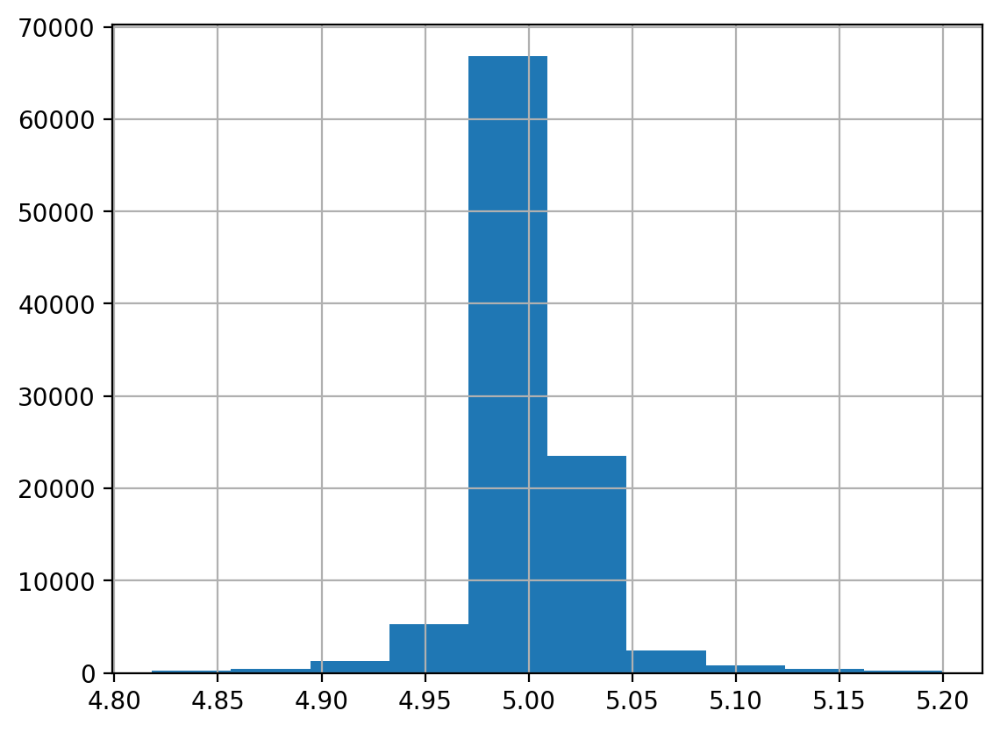

In [37]:
airbnb['RATIO_FEE'].hist()

In [38]:
airbnb['RATIO_FEE'].describe(percentiles=np.linspace(0, 1, 11))

count   101,572.00
mean          5.00
std           0.03
min           4.82
0%            4.82
10%           4.98
20%           4.99
30%           4.99
40%           5.00
50%           5.00
60%           5.00
70%           5.01
80%           5.01
90%           5.02
100%          5.20
max           5.20
Name: RATIO_FEE, dtype: float64

In [39]:
airbnb['RATIO_FEE_CAT'] = pd.cut(airbnb['RATIO_FEE'], bins=2, labels=["LOW", "HIGH"])

<Axes: xlabel='RATIO_FEE_CAT'>

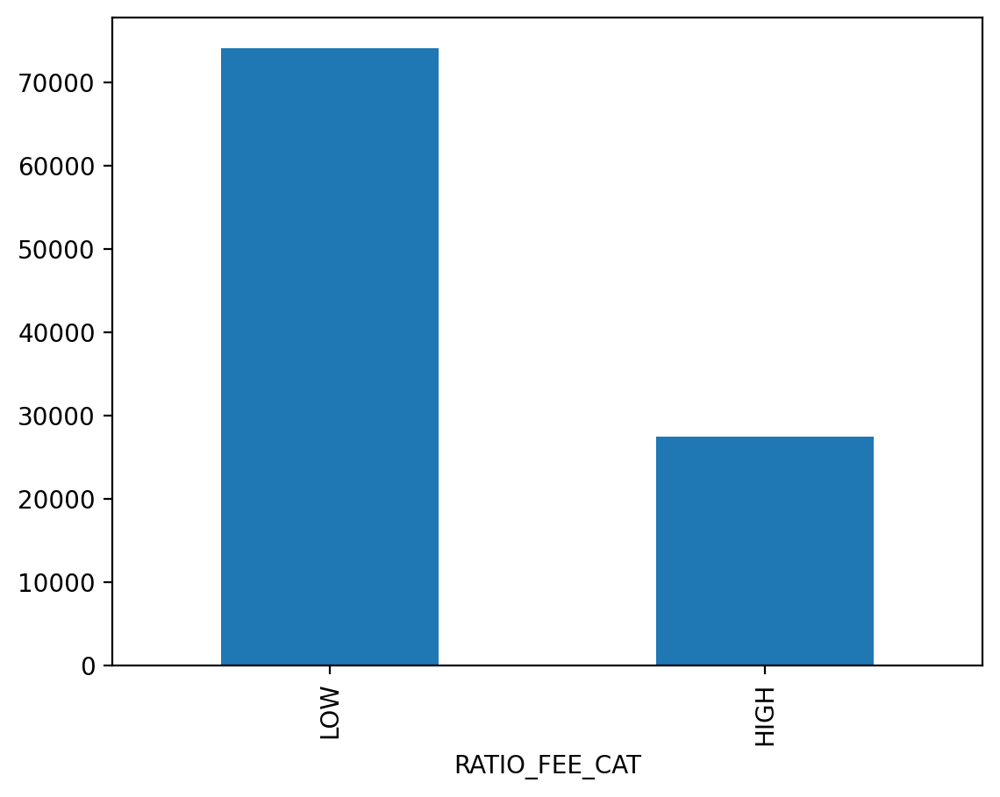

In [40]:
airbnb['RATIO_FEE_CAT'].value_counts().plot(kind='bar')

Inconsistencia de datos en `LAST_REVIEW`, cuenta con datos en la columna de fecha muy altos

In [41]:
# airbnb[airbnb['LAST_REVIEW'] == airbnb['LAST_REVIEW'].max()]

# # Año de la ultima revision
# airbnb['LAST_YEAR_REVIEW'] = airbnb['LAST_REVIEW'].dt.year
# airbnb['LAST_YEAR_REVIEW'] = airbnb['LAST_YEAR_REVIEW'].fillna(0).astype(int)

# airbnb['LAST_YEAR_REVIEW'].value_counts().sort_index().plot(kind='bar', figsize=(12, 5), title='Ultimo año de revision')

# # Mes de la ultima revision
# airbnb['LAST_MONTH_REVIEW'] = airbnb['LAST_REVIEW'].dt.month

# airbnb['LAST_MONTH_REVIEW'].value_counts().sort_index().plot(kind='bar', figsize=(12, 5), title='Ultimo mes de revision')

# # Mes de la ultima revision
# airbnb['LAST_DAY_REVIEW'] = airbnb['LAST_REVIEW'].dt.day
# airbnb['LAST_DAY_REVIEW'].value_counts().sort_index().plot(kind='bar', figsize=(12, 5), title='Ultimo dia de revision')

# airbnb['week_day'] = airbnb['last review'].map( lambda x: x.weekday() )
# airbnb['week_day_str'] = airbnb['week_day'].map( dict( zip( range(0, 7, 1), 'LMXJVSD' ) ) )
# airbnb['week_day'].value_counts().sort_index().plot(kind='bar', figsize=(12, 5), title='Dia de la semana')

Ubicacion de los host con los datos `lat` y `long`.

In [42]:
airbnb[(airbnb['LAT'].isna()) | (airbnb['LONG'].isna())].shape

(8, 29)

In [43]:
print("Total de registros iniciales: ",airbnb.shape[0])
airbnb = airbnb[~(airbnb['LAT'].isna()) | ~(airbnb['LONG'].isna())]
print("Total de registros finales", airbnb.shape[0])

Total de registros iniciales:  102058
Total de registros finales 102050


array([[<Axes: title={'center': 'LAT'}>,
        <Axes: title={'center': 'LONG'}>]], dtype=object)

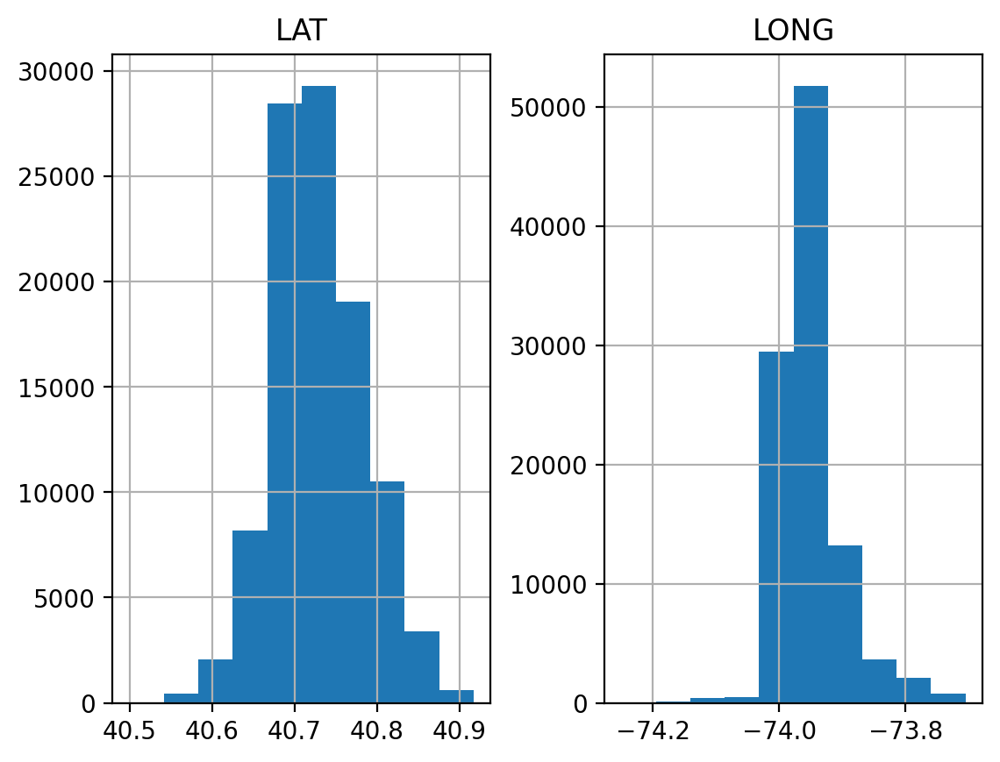

In [44]:
airbnb[['LAT', 'LONG']].hist()

In [45]:
# solo para visualizacion de los datos en el mapa
def func_color (tip_room): 

    if tip_room == 'Entire home/apt':
        r = "red"
    elif tip_room == "Private room":
        r = "blue"
    elif tip_room == "Shared room":
        r = "green"
    else:
        r = "white"
    
    return r

In [46]:
airbnb['ROOM_TYPE_COLOR'] = airbnb['ROOM_TYPE'].map(lambda x: func_color(x) )
airbnb[['ROOM_TYPE_COLOR', 'ROOM_TYPE']].head()

,ROOM_TYPE_COLOR,ROOM_TYPE
0,blue,Private room
1,red,Entire home/apt
2,blue,Private room
3,red,Entire home/apt
4,red,Entire home/apt


In [47]:
import folium

m = folium.Map(location=[airbnb['LAT'].iloc[74], airbnb['LONG'].iloc[74]], zoom_start=13)

def agregar_marcador_apply(row):
    folium.Marker(
        location=[row['LAT'], row['LONG']],
        #tooltip=row.get('id', None),
        popup=f'{row.get('ROOM_TYPE', None)} : {row.get('price', None)}',
        icon=folium.Icon(icon=row.get('icono', 'info-sign'), color=row.get('ROOM_TYPE_COLOR', None))
    ).add_to(m)

#airbnb[~(airbnb['LAT'].isna()) | ~(airbnb['LONG'].isna())].sample(2000).apply(agregar_marcador_apply, axis=1)  # axis=1 para aplicar a filas
airbnb.sample(2000).apply(agregar_marcador_apply, axis=1)  # axis=1 para aplicar a filas

m # Mostrar el mapa

In [48]:
# funcion para calcular la distancia entre dos puntos basandose en lat,long 
def haversine(lon1, lat1, lon2, lat2):
    lon1 = np.radians(lon1)
    lat1 = np.radians(lat1)
    lon2 = np.radians(lon2)
    lat2 = np.radians(lat2)
    r = 6371
    dlon = np.subtract(lon2, lon1)
    dlat = np.subtract(lat2, lat1)
    a = np.add(np.power(np.sin(np.divide(dlat, 2)), 2),
               np.multiply(np.cos(lat1),
                           np.multiply(np.cos(lat2),
                                       np.power(np.sin(np.divide(dlon, 2)), 2))
                           )
              )
    c = np.multiply(2, np.arcsin(np.sqrt(a)))
    return c*r

In [49]:
airbnb.columns

Index(['ID', 'NAME', 'HOST_ID', 'HOST_IDENTITY_VERIFIED', 'HOST_NAME',
       'NEIGHBOURHOOD_GROUP', 'NEIGHBOURHOOD', 'LAT', 'LONG', 'COUNTRY',
       'COUNTRY_CODE', 'INSTANT_BOOKABLE', 'CANCELLATION_POLICY', 'ROOM_TYPE',
       'CONSTRUCTION_YEAR', 'PRICE', 'SERVICE_FEE', 'MINIMUM_NIGHTS',
       'NUMBER_OF_REVIEWS', 'LAST_REVIEW', 'REVIEWS_PER_MONTH',
       'REVIEW_RATE_NUMBER', 'CALCULATED_HOST_LISTINGS_COUNT',
       'AVAILABILITY_365', 'HOUSE_RULES', 'LICENSE', 'TOTAL_PRICE',
       'RATIO_FEE', 'RATIO_FEE_CAT', 'ROOM_TYPE_COLOR'],
      dtype='object')

In [50]:
# punto del centro de la ciudad
city_center = (40.7580, -73.9855)
airbnb['DIST_CENTER_CITY'] = airbnb.apply(lambda x: haversine(lon1=x['LONG'], lat1=x['LAT'], lon2=city_center[1], lat2=city_center[0]), axis=1)

Revisiones por mes, asumiento que si no existe un dato es que no tiene revisiones aun

In [51]:
# airbnb[airbnb['REVIEWS_PER_MONTH'].isna()][['ID', 'REVIEWS_PER_MONTH']]
airbnb['REVIEWS_PER_MONTH'].isna().value_counts()

REVIEWS_PER_MONTH
False    86233
True     15817
Name: count, dtype: int64

In [52]:
airbnb['REVIEWS_PER_MONTH'] = airbnb['REVIEWS_PER_MONTH'].fillna(0) # los registros sin valor se colocan en 0
# airbnb[airbnb['REVIEWS_PER_MONTH'].isna()][['ID', 'REVIEWS_PER_MONTH']]
airbnb['REVIEWS_PER_MONTH'].isna().value_counts()

REVIEWS_PER_MONTH
False    102050
Name: count, dtype: int64

In [53]:
airbnb.head()

,ID,NAME,HOST_ID,HOST_IDENTITY_VERIFIED,HOST_NAME,NEIGHBOURHOOD_GROUP,NEIGHBOURHOOD,LAT,LONG,COUNTRY,COUNTRY_CODE,INSTANT_BOOKABLE,CANCELLATION_POLICY,ROOM_TYPE,CONSTRUCTION_YEAR,PRICE,SERVICE_FEE,MINIMUM_NIGHTS,NUMBER_OF_REVIEWS,LAST_REVIEW,REVIEWS_PER_MONTH,REVIEW_RATE_NUMBER,CALCULATED_HOST_LISTINGS_COUNT,AVAILABILITY_365,HOUSE_RULES,LICENSE,TOTAL_PRICE,RATIO_FEE,RATIO_FEE_CAT,ROOM_TYPE_COLOR,DIST_CENTER_CITY
0,1001254,Clean & quiet apt home by the park,80014485718,unconfirmed,Madaline,Brooklyn,Kensington,40.65,-73.97,United States,US,False,strict,Private room,"2,020.00",966.00,193.00,10.00,9.00,2021-10-19,0.21,4.00,6.00,286.00,Clean up and treat the home the way you'd like...,NaN,"1,159.00",5.01,LOW,blue,12.34
1,1002102,Skylit Midtown Castle,52335172823,verified,Jenna,Manhattan,Midtown,40.75,-73.98,United States,US,False,moderate,Entire home/apt,"2,007.00",142.00,28.00,30.00,45.00,2022-05-21,0.38,4.00,2.00,228.00,Pet friendly but please confirm with me if the...,NaN,170.00,5.07,HIGH,red,0.51
2,1002403,THE VILLAGE OF HARLEM....NEW YORK !,78829239556,NaN,Elise,Manhattan,Harlem,40.81,-73.94,United States,US,True,flexible,Private room,"2,005.00",620.00,124.00,3.00,0.00,NaT,0.00,5.00,1.00,352.00,"I encourage you to use my kitchen, cooking and...",NaN,744.00,5.00,LOW,blue,6.76
3,1002755,NaN,85098326012,unconfirmed,Garry,Brooklyn,Clinton Hill,40.69,-73.96,United States,US,True,moderate,Entire home/apt,"2,005.00",368.00,74.00,30.00,270.00,2019-07-05,4.64,4.00,1.00,322.00,NaN,NaN,442.00,4.97,LOW,red,8.39
4,1003689,Entire Apt: Spacious Studio/Loft by central park,92037596077,verified,Lyndon,Manhattan,East Harlem,40.80,-73.94,United States,US,False,moderate,Entire home/apt,"2,009.00",204.00,41.00,10.00,9.00,2018-11-19,0.10,3.00,1.00,289.00,"Please no smoking in the house, porch or on th...",NaN,245.00,4.98,LOW,red,5.70


Minimo de noches y precio, se tiene un precio establecido, y un minimo de noche.

Para el valor de `MINIMUM_NIGHTS`, contiene valores negativos, y algunos valores muy altos. Estos los consideramos como valores extremos outliuers, y los identificamos a traves de los percentiles $99$ y $1$.

In [54]:
airbnb['MINIMUM_NIGHTS'].describe(percentiles=np.linspace(0, 1, 11))

count   101,650.00
mean          8.13
std          30.62
min      -1,223.00
0%       -1,223.00
10%           1.00
20%           1.00
30%           2.00
40%           2.00
50%           3.00
60%           3.00
70%           4.00
80%           7.00
90%          30.00
100%      5,645.00
max       5,645.00
Name: MINIMUM_NIGHTS, dtype: float64

In [55]:
# obtenemos el valor para filtro de extremos
airbnb['MINIMUM_NIGHTS'].quantile(0.99), airbnb['MINIMUM_NIGHTS'].quantile(0.01)

(np.float64(50.0), np.float64(1.0))

In [56]:
print(airbnb.shape)
print("Total de valores mayores extremos superiores: ", airbnb[airbnb['MINIMUM_NIGHTS'] > airbnb['MINIMUM_NIGHTS'].quantile(0.99)].shape)
print("Total de valores extremos inferiores: ", airbnb[airbnb['MINIMUM_NIGHTS'] < airbnb['MINIMUM_NIGHTS'].quantile(0.1)].shape)

(102050, 31)
Total de valores mayores extremos superiores:  (1016, 31)
Total de valores extremos inferiores:  (13, 31)


In [57]:
# Eliminamos valores extremos
airbnb = airbnb[(airbnb['MINIMUM_NIGHTS'] < airbnb['MINIMUM_NIGHTS'].quantile(0.99)) & (airbnb['MINIMUM_NIGHTS'] >= airbnb['MINIMUM_NIGHTS'].quantile(0.1))]
airbnb.shape

(100588, 31)

Los valores para el minimo de las noches se encuentran entre $1$ y $48$.

In [58]:
airbnb['MINIMUM_NIGHTS'].describe()

count   100,588.00
mean          6.70
std           9.57
min           1.00
25%           1.00
50%           3.00
75%           5.00
max          48.00
Name: MINIMUM_NIGHTS, dtype: float64

<Axes: >

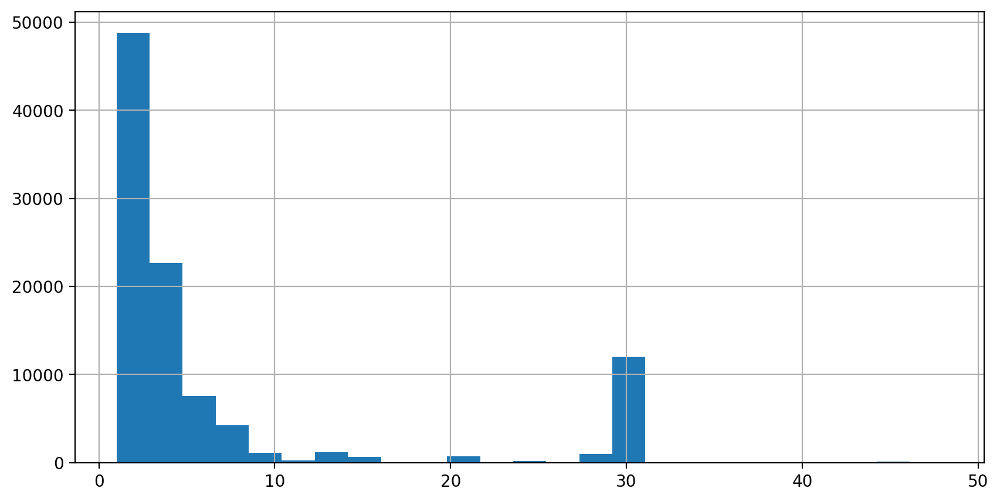

In [59]:
airbnb['MINIMUM_NIGHTS'].hist(bins=25, figsize=(10, 5))

La variable `AVAILABILITY_365` nos indica la disponibilidad del alojamiento dentro de 365 dias, los valores deben estar entre $0$ y $365$.

In [60]:
airbnb['AVAILABILITY_365'].describe(percentiles=[.01, .02, .03, .1, .25, .5, .75, .9, .97, .98, .99])

count   100,167.00
mean        140.51
std         135.41
min         -10.00
1%            0.00
2%            0.00
3%            0.00
10%           0.00
25%           3.00
50%          95.00
75%         268.00
90%         350.00
97%         365.00
98%         381.00
99%         403.00
max       3,677.00
Name: AVAILABILITY_365, dtype: float64

In [61]:
airbnb = airbnb[(airbnb['AVAILABILITY_365'] >= 0) & (airbnb['AVAILABILITY_365'] <= 365)]
airbnb['AVAILABILITY_365'].describe(percentiles=np.linspace(0, 1, 21))

count   97,034.00
mean       133.98
std        129.76
min          0.00
0%           0.00
5%           0.00
10%          0.00
15%          0.00
20%          0.00
25%          2.00
30%         14.00
35%         32.00
40%         52.00
45%         73.00
50%         90.00
55%        124.00
60%        156.00
65%        180.00
70%        216.00
75%        253.00
80%        287.00
85%        318.00
90%        340.00
95%        360.00
100%       365.00
max        365.00
Name: AVAILABILITY_365, dtype: float64

Agrupamos la disponibilidad en tres grupos, (alta, media y baja)

<Axes: title={'center': 'Distribucion de disponibilidad'}, xlabel='AVAILABILITY_365_CAT'>

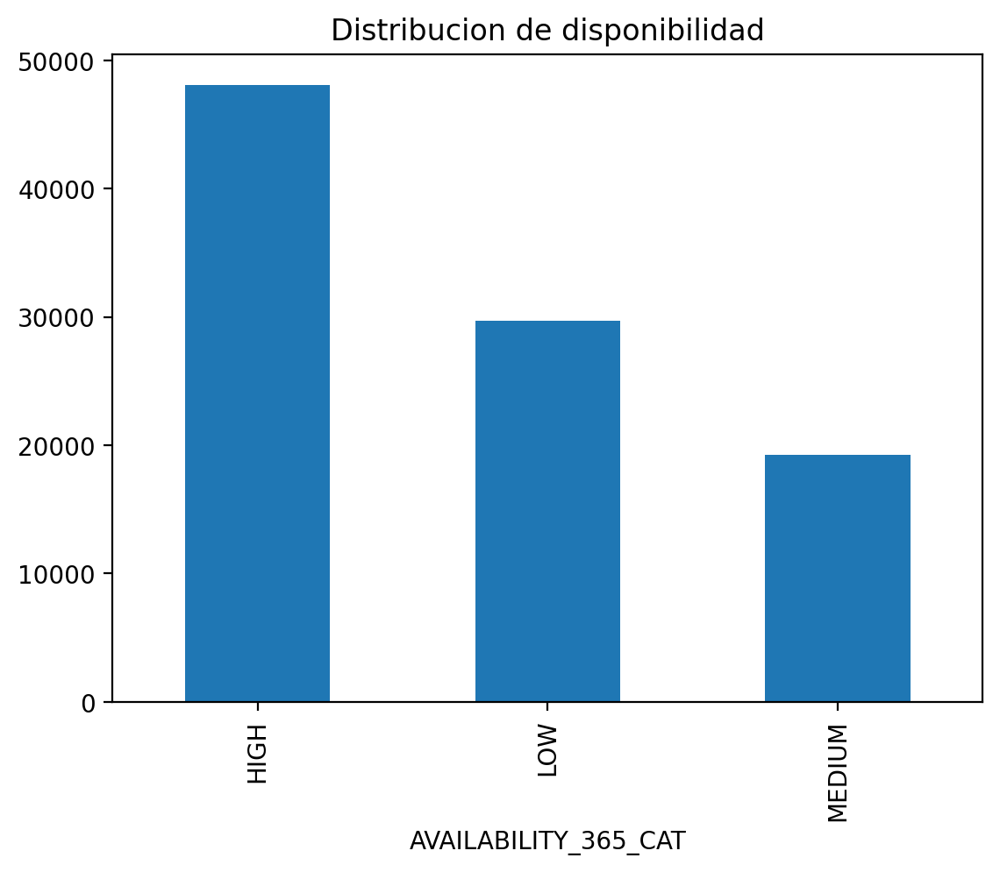

In [62]:
airbnb['AVAILABILITY_365_CAT'] = pd.cut( airbnb['AVAILABILITY_365'], bins=[-1, 15, 90, 365], labels=['LOW', 'MEDIUM', 'HIGH'])
airbnb['AVAILABILITY_365_CAT'].value_counts().plot(kind='bar', title='Distribucion de disponibilidad')

Cambio de formato de variables `Binarias`.

In [63]:
airbnb['HOST_IDENTITY_VERIFIED_2'] = airbnb['HOST_IDENTITY_VERIFIED'].map({'verified': 1, 'unconfirmed': 0, np.nan: 2})
airbnb['HOST_IDENTITY_VERIFIED_2'].value_counts()

HOST_IDENTITY_VERIFIED_2
0    48428
1    48357
2      249
Name: count, dtype: int64

In [64]:
airbnb[airbnb['HOST_IDENTITY_VERIFIED_2'].isna()]

,ID,NAME,HOST_ID,HOST_IDENTITY_VERIFIED,HOST_NAME,NEIGHBOURHOOD_GROUP,NEIGHBOURHOOD,LAT,LONG,COUNTRY,COUNTRY_CODE,INSTANT_BOOKABLE,CANCELLATION_POLICY,ROOM_TYPE,CONSTRUCTION_YEAR,PRICE,SERVICE_FEE,MINIMUM_NIGHTS,NUMBER_OF_REVIEWS,LAST_REVIEW,REVIEWS_PER_MONTH,REVIEW_RATE_NUMBER,CALCULATED_HOST_LISTINGS_COUNT,AVAILABILITY_365,HOUSE_RULES,LICENSE,TOTAL_PRICE,RATIO_FEE,RATIO_FEE_CAT,ROOM_TYPE_COLOR,DIST_CENTER_CITY,AVAILABILITY_365_CAT,HOST_IDENTITY_VERIFIED_2


In [65]:
airbnb.head(8)

,ID,NAME,HOST_ID,HOST_IDENTITY_VERIFIED,HOST_NAME,NEIGHBOURHOOD_GROUP,NEIGHBOURHOOD,LAT,LONG,COUNTRY,COUNTRY_CODE,INSTANT_BOOKABLE,CANCELLATION_POLICY,ROOM_TYPE,CONSTRUCTION_YEAR,PRICE,SERVICE_FEE,MINIMUM_NIGHTS,NUMBER_OF_REVIEWS,LAST_REVIEW,REVIEWS_PER_MONTH,REVIEW_RATE_NUMBER,CALCULATED_HOST_LISTINGS_COUNT,AVAILABILITY_365,HOUSE_RULES,LICENSE,TOTAL_PRICE,RATIO_FEE,RATIO_FEE_CAT,ROOM_TYPE_COLOR,DIST_CENTER_CITY,AVAILABILITY_365_CAT,HOST_IDENTITY_VERIFIED_2
0,1001254,Clean & quiet apt home by the park,80014485718,unconfirmed,Madaline,Brooklyn,Kensington,40.65,-73.97,United States,US,False,strict,Private room,"2,020.00",966.00,193.00,10.00,9.00,2021-10-19,0.21,4.00,6.00,286.00,Clean up and treat the home the way you'd like...,NaN,"1,159.00",5.01,LOW,blue,12.34,HIGH,0
1,1002102,Skylit Midtown Castle,52335172823,verified,Jenna,Manhattan,Midtown,40.75,-73.98,United States,US,False,moderate,Entire home/apt,"2,007.00",142.00,28.00,30.00,45.00,2022-05-21,0.38,4.00,2.00,228.00,Pet friendly but please confirm with me if the...,NaN,170.00,5.07,HIGH,red,0.51,HIGH,1
2,1002403,THE VILLAGE OF HARLEM....NEW YORK !,78829239556,NaN,Elise,Manhattan,Harlem,40.81,-73.94,United States,US,True,flexible,Private room,"2,005.00",620.00,124.00,3.00,0.00,NaT,0.00,5.00,1.00,352.00,"I encourage you to use my kitchen, cooking and...",NaN,744.00,5.00,LOW,blue,6.76,HIGH,2
3,1002755,NaN,85098326012,unconfirmed,Garry,Brooklyn,Clinton Hill,40.69,-73.96,United States,US,True,moderate,Entire home/apt,"2,005.00",368.00,74.00,30.00,270.00,2019-07-05,4.64,4.00,1.00,322.00,NaN,NaN,442.00,4.97,LOW,red,8.39,HIGH,0
4,1003689,Entire Apt: Spacious Studio/Loft by central park,92037596077,verified,Lyndon,Manhattan,East Harlem,40.80,-73.94,United States,US,False,moderate,Entire home/apt,"2,009.00",204.00,41.00,10.00,9.00,2018-11-19,0.10,3.00,1.00,289.00,"Please no smoking in the house, porch or on th...",NaN,245.00,4.98,LOW,red,5.70,HIGH,1
6,1004650,BlissArtsSpace!,61300605564,NaN,Alberta,Brooklyn,Bedford-Stuyvesant,40.69,-73.96,United States,US,False,moderate,Private room,"2,015.00",71.00,14.00,45.00,49.00,2017-10-05,0.40,5.00,1.00,224.00,Please no shoes in the house so bring slippers...,NaN,85.00,5.07,HIGH,blue,8.29,HIGH,2
7,1005202,BlissArtsSpace!,90821839709,unconfirmed,Emma,Brooklyn,Bedford-Stuyvesant,40.69,-73.96,United States,US,False,moderate,Private room,"2,009.00","1,060.00",212.00,45.00,49.00,2017-10-05,0.40,5.00,1.00,219.00,House Guidelines for our BnB We are delighted ...,NaN,"1,272.00",5.00,LOW,blue,8.29,HIGH,0
8,1005754,Large Furnished Room Near B'way,79384379533,verified,Evelyn,Manhattan,Hell's Kitchen,40.76,-73.98,United States,US,True,strict,Private room,"2,005.00","1,018.00",204.00,2.00,430.00,2019-06-24,3.47,3.00,1.00,180.00,- Please clean up after yourself when using th...,NaN,"1,222.00",4.99,LOW,blue,0.77,HIGH,1


Limpiamos los datos para `NEIGHBOURHOOD_GROUP`.

In [66]:
airbnb['NEIGHBOURHOOD_GROUP'].value_counts()

NEIGHBOURHOOD_GROUP
Manhattan        41104
Brooklyn         39635
Queens           12755
Bronx             2603
Staten Island      920
brookln              1
manhatan             1
Name: count, dtype: int64

In [67]:
airbnb.loc[airbnb['NEIGHBOURHOOD_GROUP'] == 'manhatan', ['NEIGHBOURHOOD_GROUP']] = 'Manhattan'
airbnb.loc[airbnb['NEIGHBOURHOOD_GROUP'] == 'brookln', ['NEIGHBOURHOOD_GROUP']] = 'Brooklyn'

In [68]:
airbnb['NEIGHBOURHOOD_GROUP'].value_counts()

NEIGHBOURHOOD_GROUP
Manhattan        41105
Brooklyn         39636
Queens           12755
Bronx             2603
Staten Island      920
Name: count, dtype: int64

Obtenemos el `min`, `max`, `mean` para la variable de precio, agrupado por las variables categoricas `AVAILABILITY_365_CAT`, `ROOM_TYPE`, `NEIGHBOURHOOD_GROUP`. Agregamos los nuevos valores a el DataFrame.

In [69]:
airbnb_agg = airbnb[['ROOM_TYPE', 'PRICE', 'NEIGHBOURHOOD_GROUP', 'AVAILABILITY_365_CAT']]\
                .groupby(['AVAILABILITY_365_CAT','ROOM_TYPE', 'NEIGHBOURHOOD_GROUP'])\
                .agg( {'PRICE': ['min', 'max', 'mean']} )\
                .reset_index()
                #.rename(columns=['MIN_PRICE','MAX_PRICE','MEAN_PRICE'])

airbnb_agg.head()

AVAILABILITY_365_CAT        ROOM_TYPE NEIGHBOURHOOD_GROUP PRICE           \
                                                              min      max   
0                  LOW  Entire home/apt               Bronx 66.00 1,186.00   
1                  LOW  Entire home/apt            Brooklyn 50.00 1,200.00   
2                  LOW  Entire home/apt           Manhattan 51.00 1,200.00   
3                  LOW  Entire home/apt              Queens 50.00 1,198.00   
4                  LOW  Entire home/apt       Staten Island 59.00 1,160.00   

          
    mean  
0 568.14  
1 626.27  
2 626.89  
3 633.86  
4 719.45

In [70]:
# Cambio de nombre de columna
airbnb_agg.columns = [c[0]+'_'+str(c[1]).upper()+'_AVAIL_ROOM_NEIGHB' if c[1] != '' else c[0] for c in airbnb_agg.columns]
airbnb_agg.head()

,AVAILABILITY_365_CAT,ROOM_TYPE,NEIGHBOURHOOD_GROUP,PRICE_MIN_AVAIL_ROOM_NEIGHB,PRICE_MAX_AVAIL_ROOM_NEIGHB,PRICE_MEAN_AVAIL_ROOM_NEIGHB
0,LOW,Entire home/apt,Bronx,66.00,"1,186.00",568.14
1,LOW,Entire home/apt,Brooklyn,50.00,"1,200.00",626.27
2,LOW,Entire home/apt,Manhattan,51.00,"1,200.00",626.89
3,LOW,Entire home/apt,Queens,50.00,"1,198.00",633.86
4,LOW,Entire home/apt,Staten Island,59.00,"1,160.00",719.45


In [71]:
# Concatenamos los datos al dataframe principal
airbnb = airbnb.merge(airbnb_agg, on=['AVAILABILITY_365_CAT', 'ROOM_TYPE', 'NEIGHBOURHOOD_GROUP'], how='left')
airbnb.head()

,ID,NAME,HOST_ID,HOST_IDENTITY_VERIFIED,HOST_NAME,NEIGHBOURHOOD_GROUP,NEIGHBOURHOOD,LAT,LONG,COUNTRY,COUNTRY_CODE,INSTANT_BOOKABLE,CANCELLATION_POLICY,ROOM_TYPE,CONSTRUCTION_YEAR,PRICE,SERVICE_FEE,MINIMUM_NIGHTS,NUMBER_OF_REVIEWS,LAST_REVIEW,REVIEWS_PER_MONTH,REVIEW_RATE_NUMBER,CALCULATED_HOST_LISTINGS_COUNT,AVAILABILITY_365,HOUSE_RULES,LICENSE,TOTAL_PRICE,RATIO_FEE,RATIO_FEE_CAT,ROOM_TYPE_COLOR,DIST_CENTER_CITY,AVAILABILITY_365_CAT,HOST_IDENTITY_VERIFIED_2,PRICE_MIN_AVAIL_ROOM_NEIGHB,PRICE_MAX_AVAIL_ROOM_NEIGHB,PRICE_MEAN_AVAIL_ROOM_NEIGHB
0,1001254,Clean & quiet apt home by the park,80014485718,unconfirmed,Madaline,Brooklyn,Kensington,40.65,-73.97,United States,US,False,strict,Private room,"2,020.00",966.00,193.00,10.00,9.00,2021-10-19,0.21,4.00,6.00,286.00,Clean up and treat the home the way you'd like...,NaN,"1,159.00",5.01,LOW,blue,12.34,HIGH,0,50.00,"1,200.00",618.94
1,1002102,Skylit Midtown Castle,52335172823,verified,Jenna,Manhattan,Midtown,40.75,-73.98,United States,US,False,moderate,Entire home/apt,"2,007.00",142.00,28.00,30.00,45.00,2022-05-21,0.38,4.00,2.00,228.00,Pet friendly but please confirm with me if the...,NaN,170.00,5.07,HIGH,red,0.51,HIGH,1,50.00,"1,200.00",626.30
2,1002403,THE VILLAGE OF HARLEM....NEW YORK !,78829239556,NaN,Elise,Manhattan,Harlem,40.81,-73.94,United States,US,True,flexible,Private room,"2,005.00",620.00,124.00,3.00,0.00,NaT,0.00,5.00,1.00,352.00,"I encourage you to use my kitchen, cooking and...",NaN,744.00,5.00,LOW,blue,6.76,HIGH,2,50.00,"1,200.00",617.02
3,1002755,NaN,85098326012,unconfirmed,Garry,Brooklyn,Clinton Hill,40.69,-73.96,United States,US,True,moderate,Entire home/apt,"2,005.00",368.00,74.00,30.00,270.00,2019-07-05,4.64,4.00,1.00,322.00,NaN,NaN,442.00,4.97,LOW,red,8.39,HIGH,0,50.00,"1,200.00",634.78
4,1003689,Entire Apt: Spacious Studio/Loft by central park,92037596077,verified,Lyndon,Manhattan,East Harlem,40.80,-73.94,United States,US,False,moderate,Entire home/apt,"2,009.00",204.00,41.00,10.00,9.00,2018-11-19,0.10,3.00,1.00,289.00,"Please no smoking in the house, porch or on th...",NaN,245.00,4.98,LOW,red,5.70,HIGH,1,50.00,"1,200.00",626.30


In [72]:
airbnb.columns

Index(['ID', 'NAME', 'HOST_ID', 'HOST_IDENTITY_VERIFIED', 'HOST_NAME',
       'NEIGHBOURHOOD_GROUP', 'NEIGHBOURHOOD', 'LAT', 'LONG', 'COUNTRY',
       'COUNTRY_CODE', 'INSTANT_BOOKABLE', 'CANCELLATION_POLICY', 'ROOM_TYPE',
       'CONSTRUCTION_YEAR', 'PRICE', 'SERVICE_FEE', 'MINIMUM_NIGHTS',
       'NUMBER_OF_REVIEWS', 'LAST_REVIEW', 'REVIEWS_PER_MONTH',
       'REVIEW_RATE_NUMBER', 'CALCULATED_HOST_LISTINGS_COUNT',
       'AVAILABILITY_365', 'HOUSE_RULES', 'LICENSE', 'TOTAL_PRICE',
       'RATIO_FEE', 'RATIO_FEE_CAT', 'ROOM_TYPE_COLOR', 'DIST_CENTER_CITY',
       'AVAILABILITY_365_CAT', 'HOST_IDENTITY_VERIFIED_2',
       'PRICE_MIN_AVAIL_ROOM_NEIGHB', 'PRICE_MAX_AVAIL_ROOM_NEIGHB',
       'PRICE_MEAN_AVAIL_ROOM_NEIGHB'],
      dtype='object')

In [73]:
airbnb['LAST_REVIEW'] = pd.to_datetime(airbnb['LAST_REVIEW'])
airbnb['LAST_REVIEW_YEAR'] = airbnb['LAST_REVIEW'].map( lambda x: x.year)
airbnb['LAST_REVIEW_YEAR'].describe()

count   82,474.00
mean     2,019.04
std          1.65
min      2,012.00
25%      2,018.00
50%      2,019.00
75%      2,019.00
max      2,058.00
Name: LAST_REVIEW_YEAR, dtype: float64

In [74]:
airbnb['LAST_REVIEW_MONTH'] = airbnb['LAST_REVIEW'].map( lambda x: x.month )
airbnb['LAST_REVIEW_MONTH'].describe(percentiles=np.linspace(0, 1, 11))

count   82,474.00
mean         5.88
std          3.03
min          1.00
0%           1.00
10%          1.00
20%          3.00
30%          5.00
40%          6.00
50%          6.00
60%          6.00
70%          7.00
80%          8.00
90%         10.00
100%        12.00
max         12.00
Name: LAST_REVIEW_MONTH, dtype: float64

In [75]:
airbnb.shape

(97034, 38)

In [76]:
airbnb_agg2 = airbnb[['ROOM_TYPE', 'LAST_REVIEW_MONTH', 'LAST_REVIEW_YEAR', 'PRICE']]\
                .groupby(['ROOM_TYPE', 'LAST_REVIEW_MONTH', 'LAST_REVIEW_YEAR'])\
                .agg(['min', 'max', 'mean']).reset_index()
airbnb_agg2.head()

ROOM_TYPE LAST_REVIEW_MONTH LAST_REVIEW_YEAR  PRICE                
                                                         min      max   mean
0  Entire home/apt              1.00         2,013.00 400.00 1,183.00 687.50
1  Entire home/apt              1.00         2,014.00 205.00 1,039.00 487.60
2  Entire home/apt              1.00         2,015.00  86.00 1,183.00 615.32
3  Entire home/apt              1.00         2,016.00  52.00 1,197.00 585.64
4  Entire home/apt              1.00         2,017.00  56.00 1,190.00 628.47

In [77]:
# Cambio de nombre de columna
airbnb_agg2.columns = [c[0]+'_'+str(c[1]).upper()+'_ROOM_MONTH_YEAR' if c[1] != '' else c[0] for c in airbnb_agg2.columns]
airbnb_agg2.head()

,ROOM_TYPE,LAST_REVIEW_MONTH,LAST_REVIEW_YEAR,PRICE_MIN_ROOM_MONTH_YEAR,PRICE_MAX_ROOM_MONTH_YEAR,PRICE_MEAN_ROOM_MONTH_YEAR
0,Entire home/apt,1.00,"2,013.00",400.00,"1,183.00",687.50
1,Entire home/apt,1.00,"2,014.00",205.00,"1,039.00",487.60
2,Entire home/apt,1.00,"2,015.00",86.00,"1,183.00",615.32
3,Entire home/apt,1.00,"2,016.00",52.00,"1,197.00",585.64
4,Entire home/apt,1.00,"2,017.00",56.00,"1,190.00",628.47


In [78]:
airbnb = airbnb.merge(airbnb_agg2, on=['ROOM_TYPE', 'LAST_REVIEW_MONTH', 'LAST_REVIEW_YEAR'], how='left')
airbnb.head()

,ID,NAME,HOST_ID,HOST_IDENTITY_VERIFIED,HOST_NAME,NEIGHBOURHOOD_GROUP,NEIGHBOURHOOD,LAT,LONG,COUNTRY,COUNTRY_CODE,INSTANT_BOOKABLE,CANCELLATION_POLICY,ROOM_TYPE,CONSTRUCTION_YEAR,PRICE,SERVICE_FEE,MINIMUM_NIGHTS,NUMBER_OF_REVIEWS,LAST_REVIEW,REVIEWS_PER_MONTH,REVIEW_RATE_NUMBER,CALCULATED_HOST_LISTINGS_COUNT,AVAILABILITY_365,HOUSE_RULES,LICENSE,TOTAL_PRICE,RATIO_FEE,RATIO_FEE_CAT,ROOM_TYPE_COLOR,DIST_CENTER_CITY,AVAILABILITY_365_CAT,HOST_IDENTITY_VERIFIED_2,PRICE_MIN_AVAIL_ROOM_NEIGHB,PRICE_MAX_AVAIL_ROOM_NEIGHB,PRICE_MEAN_AVAIL_ROOM_NEIGHB,LAST_REVIEW_YEAR,LAST_REVIEW_MONTH,PRICE_MIN_ROOM_MONTH_YEAR,PRICE_MAX_ROOM_MONTH_YEAR,PRICE_MEAN_ROOM_MONTH_YEAR
0,1001254,Clean & quiet apt home by the park,80014485718,unconfirmed,Madaline,Brooklyn,Kensington,40.65,-73.97,United States,US,False,strict,Private room,"2,020.00",966.00,193.00,10.00,9.00,2021-10-19,0.21,4.00,6.00,286.00,Clean up and treat the home the way you'd like...,NaN,"1,159.00",5.01,LOW,blue,12.34,HIGH,0,50.00,"1,200.00",618.94,"2,021.00",10.00,52.00,"1,198.00",614.66
1,1002102,Skylit Midtown Castle,52335172823,verified,Jenna,Manhattan,Midtown,40.75,-73.98,United States,US,False,moderate,Entire home/apt,"2,007.00",142.00,28.00,30.00,45.00,2022-05-21,0.38,4.00,2.00,228.00,Pet friendly but please confirm with me if the...,NaN,170.00,5.07,HIGH,red,0.51,HIGH,1,50.00,"1,200.00",626.30,"2,022.00",5.00,142.00,142.00,142.00
2,1002403,THE VILLAGE OF HARLEM....NEW YORK !,78829239556,NaN,Elise,Manhattan,Harlem,40.81,-73.94,United States,US,True,flexible,Private room,"2,005.00",620.00,124.00,3.00,0.00,NaT,0.00,5.00,1.00,352.00,"I encourage you to use my kitchen, cooking and...",NaN,744.00,5.00,LOW,blue,6.76,HIGH,2,50.00,"1,200.00",617.02,NaN,NaN,NaN,NaN,NaN
3,1002755,NaN,85098326012,unconfirmed,Garry,Brooklyn,Clinton Hill,40.69,-73.96,United States,US,True,moderate,Entire home/apt,"2,005.00",368.00,74.00,30.00,270.00,2019-07-05,4.64,4.00,1.00,322.00,NaN,NaN,442.00,4.97,LOW,red,8.39,HIGH,0,50.00,"1,200.00",634.78,"2,019.00",7.00,51.00,"1,200.00",631.55
4,1003689,Entire Apt: Spacious Studio/Loft by central park,92037596077,verified,Lyndon,Manhattan,East Harlem,40.80,-73.94,United States,US,False,moderate,Entire home/apt,"2,009.00",204.00,41.00,10.00,9.00,2018-11-19,0.10,3.00,1.00,289.00,"Please no smoking in the house, porch or on th...",NaN,245.00,4.98,LOW,red,5.70,HIGH,1,50.00,"1,200.00",626.30,"2,018.00",11.00,51.00,"1,199.00",646.78


In [79]:
airbnb.to_csv("../data/Airbnb/airbnb_out.csv", index=False)

In [80]:
airbnb.shape

(97034, 41)

# Análisis Exploratorio

In [81]:
len(airbnb.columns)

41

In [82]:
# unidad muestral
um = ['ID']

# target
cols_tgt = ['PRICE', 'AVAILABILITY_365_CAT'] # Adicional se agrega una para clasificacion de disponibilidad

# columnas descartadas
cols_drop = ['HOUSE_RULES', 'LICENSE', 'NAME', 'HOST_ID', 'HOST_NAME', 'COUNTRY', 'COUNTRY_CODE',
             'ROOM_TYPE_COLOR']

# columnas numericas
cols_num = ['LAT', 'LONG', 'SERVICE_FEE', 'MINIMUM_NIGHTS', 'NUMBER_OF_REVIEWS', 'REVIEWS_PER_MONTH', 
            'REVIEW_RATE_NUMBER', 'CALCULATED_HOST_LISTINGS_COUNT', 'AVAILABILITY_365',
            'TOTAL_PRICE', 'RATIO_FEE', 'DIST_CENTER_CITY', 'PRICE_MIN_AVAIL_ROOM_NEIGHB',
             'PRICE_MAX_AVAIL_ROOM_NEIGHB', 'PRICE_MEAN_AVAIL_ROOM_NEIGHB', 'PRICE_MIN_ROOM_MONTH_YEAR',
             'PRICE_MAX_ROOM_MONTH_YEAR', 'PRICE_MEAN_ROOM_MONTH_YEAR']

# Columnas categoricas
cols_cat = ['NEIGHBOURHOOD_GROUP', 'NEIGHBOURHOOD', 'CANCELLATION_POLICY', 'ROOM_TYPE', 
            'CONSTRUCTION_YEAR', 'HOST_IDENTITY_VERIFIED_2', 'LAST_REVIEW_YEAR', 'LAST_REVIEW_MONTH', 
            'RATIO_FEE_CAT']

# columnas binarias
cols_bin = ['INSTANT_BOOKABLE', 'HOST_IDENTITY_VERIFIED']

# columnas fecha
cols_date = ['LAST_REVIEW']

In [83]:
print( len(um + cols_tgt + cols_num + cols_bin + cols_cat + cols_date + cols_drop) )

41


In [84]:
airbnb[cols_cat].dtypes

NEIGHBOURHOOD_GROUP           object
NEIGHBOURHOOD                 object
CANCELLATION_POLICY           object
ROOM_TYPE                     object
CONSTRUCTION_YEAR            float64
HOST_IDENTITY_VERIFIED_2       int64
LAST_REVIEW_YEAR             float64
LAST_REVIEW_MONTH            float64
RATIO_FEE_CAT               category
dtype: object

In [85]:
airbnb['RATIO_FEE_CAT'] = airbnb['RATIO_FEE_CAT'].astype(str)

In [86]:
airbnb[cols_cat].dtypes

NEIGHBOURHOOD_GROUP          object
NEIGHBOURHOOD                object
CANCELLATION_POLICY          object
ROOM_TYPE                    object
CONSTRUCTION_YEAR           float64
HOST_IDENTITY_VERIFIED_2      int64
LAST_REVIEW_YEAR            float64
LAST_REVIEW_MONTH           float64
RATIO_FEE_CAT                object
dtype: object

In [87]:
# la falta de información tambien es información
for col in cols_cat:
    airbnb[col] = airbnb[col].fillna("SIN CATEGORIA")

# Convertir a numeros
for col in cols_num:
    airbnb[col] = pd.to_numeric( airbnb[col], errors='coerce')

# Convertir a string
for col in cols_cat:
    airbnb[col] = airbnb[col].astype(str)


In [88]:
import seaborn as sns
sns.pairplot(airbnb[cols_num].sample(2000))

## Categoricas

Analizamos si existen registros con valores vacios

In [89]:
airbnb[cols_cat].isna().sum()

NEIGHBOURHOOD_GROUP         0
NEIGHBOURHOOD               0
CANCELLATION_POLICY         0
ROOM_TYPE                   0
CONSTRUCTION_YEAR           0
HOST_IDENTITY_VERIFIED_2    0
LAST_REVIEW_YEAR            0
LAST_REVIEW_MONTH           0
RATIO_FEE_CAT               0
dtype: int64

Análisis de frecuencias

In [90]:
airbnb[cols_cat].describe()

,NEIGHBOURHOOD_GROUP,NEIGHBOURHOOD,CANCELLATION_POLICY,ROOM_TYPE,CONSTRUCTION_YEAR,HOST_IDENTITY_VERIFIED_2,LAST_REVIEW_YEAR,LAST_REVIEW_MONTH,RATIO_FEE_CAT
count,97034,97034,97034,97034,97034,97034,97034,97034,97034
unique,6,225,4,4,21,3,15,13,3
top,Manhattan,Bedford-Stuyvesant,moderate,Entire home/apt,2014.0,0,2019.0,6.0,LOW
freq,41105,7562,32436,50567,4983,48428,41032,22534,70536


In [91]:
for col in cols_cat:
    display(freq( airbnb, col ))

Tabla de frecuencias para la variable NEIGHBOURHOOD_GROUP 

                        FA   FR    FAA  FRA
NEIGHBOURHOOD_GROUP                        
Manhattan            41105 0.42  41105 0.42
Brooklyn             39636 0.41  80741 0.83
Queens               12755 0.13  93496 0.96
Bronx                 2603 0.03  96099 0.99
Staten Island          920 0.01  97019 1.00
SIN CATEGORIA           15 0.00  97034 1.00 



None

Tabla de frecuencias para la variable NEIGHBOURHOOD 

                          FA   FR    FAA  FRA
NEIGHBOURHOOD                                
Bedford-Stuyvesant      7562 0.08   7562 0.08
Williamsburg            7350 0.08  14912 0.15
Harlem                  5116 0.05  20028 0.21
Bushwick                4735 0.05  24763 0.26
Hell's Kitchen          3779 0.04  28542 0.29
...                      ...  ...    ...  ...
Gerritsen Beach            3 0.00  97027 1.00
Fort Wadsworth             2 0.00  97029 1.00
Rossville                  2 0.00  97031 1.00
Glen Oaks                  2 0.00  97033 1.00
Chelsea, Staten Island     1 0.00  97034 1.00

[225 rows x 4 columns] 



None

Tabla de frecuencias para la variable CANCELLATION_POLICY 

                        FA   FR    FAA  FRA
CANCELLATION_POLICY                        
moderate             32436 0.33  32436 0.33
strict               32273 0.33  64709 0.67
flexible             32269 0.33  96978 1.00
SIN CATEGORIA           56 0.00  97034 1.00 



None

Tabla de frecuencias para la variable ROOM_TYPE 

                    FA   FR    FAA  FRA
ROOM_TYPE                              
Entire home/apt  50567 0.52  50567 0.52
Private room     44234 0.46  94801 0.98
Shared room       2120 0.02  96921 1.00
Hotel room         113 0.00  97034 1.00 



None

Tabla de frecuencias para la variable CONSTRUCTION_YEAR 

                     FA   FR    FAA  FRA
CONSTRUCTION_YEAR                       
2014.0             4983 0.05   4983 0.05
2008.0             4940 0.05   9923 0.10
2009.0             4935 0.05  14858 0.15
2019.0             4934 0.05  19792 0.20
2006.0             4923 0.05  24715 0.25
2020.0             4893 0.05  29608 0.31
2010.0             4893 0.05  34501 0.36
2005.0             4856 0.05  39357 0.41
2003.0             4847 0.05  44204 0.46
2022.0             4845 0.05  49049 0.51
2012.0             4837 0.05  53886 0.56
2015.0             4830 0.05  58716 0.61
2007.0             4812 0.05  63528 0.65
2017.0             4801 0.05  68329 0.70
2021.0             4783 0.05  73112 0.75
2018.0             4771 0.05  77883 0.80
2011.0             4762 0.05  82645 0.85
2016.0             4752 0.05  87397 0.90
2004.0             4742 0.05  92139 0.95
2013.0             4733 0.05  96872 1.00
SIN CATEGORIA       162 0.00  97034 1.00

None

Tabla de frecuencias para la variable HOST_IDENTITY_VERIFIED_2 

                             FA   FR    FAA  FRA
HOST_IDENTITY_VERIFIED_2                        
0                         48428 0.50  48428 0.50
1                         48357 0.50  96785 1.00
2                           249 0.00  97034 1.00 



None

Tabla de frecuencias para la variable LAST_REVIEW_YEAR 

                     FA   FR    FAA  FRA
LAST_REVIEW_YEAR                        
2019.0            41032 0.42  41032 0.42
SIN CATEGORIA     14560 0.15  55592 0.57
2018.0            10898 0.11  66490 0.69
2022.0            10221 0.11  76711 0.79
2021.0             6416 0.07  83127 0.86
2017.0             6257 0.06  89384 0.92
2016.0             3761 0.04  93145 0.96
2020.0             2009 0.02  95154 0.98
2015.0             1585 0.02  96739 1.00
2014.0              208 0.00  96947 1.00
2013.0               60 0.00  97007 1.00
2012.0               24 0.00  97031 1.00
2058.0                1 0.00  97032 1.00
2026.0                1 0.00  97033 1.00
2040.0                1 0.00  97034 1.00 



None

Tabla de frecuencias para la variable LAST_REVIEW_MONTH 

                      FA   FR    FAA  FRA
LAST_REVIEW_MONTH                        
6.0                22534 0.23  22534 0.23
SIN CATEGORIA      14560 0.15  37094 0.38
7.0                10053 0.10  47147 0.49
1.0                 8567 0.09  55714 0.57
5.0                 8159 0.08  63873 0.66
2.0                 7046 0.07  70919 0.73
12.0                5244 0.05  76163 0.78
4.0                 3778 0.04  79941 0.82
3.0                 3653 0.04  83594 0.86
10.0                3610 0.04  87204 0.90
8.0                 3504 0.04  90708 0.93
9.0                 3420 0.04  94128 0.97
11.0                2906 0.03  97034 1.00 



None

Tabla de frecuencias para la variable RATIO_FEE_CAT 

                  FA   FR    FAA  FRA
RATIO_FEE_CAT                        
LOW            70536 0.73  70536 0.73
HIGH           26048 0.27  96584 1.00
nan              450 0.00  97034 1.00 



None

### Normalización

Analiza la fecuencia de la informacion (sin normalizar)

In [92]:
for c in cols_cat:
    airbnb = norm( airbnb, c, 0.05 )

In [93]:
cols_norm = [ _ for _ in airbnb.columns.tolist() if str(_).startswith('n_') ]
cols_norm

['n_NEIGHBOURHOOD_GROUP',
 'n_NEIGHBOURHOOD',
 'n_CANCELLATION_POLICY',
 'n_ROOM_TYPE',
 'n_CONSTRUCTION_YEAR',
 'n_HOST_IDENTITY_VERIFIED_2',
 'n_LAST_REVIEW_YEAR',
 'n_LAST_REVIEW_MONTH',
 'n_RATIO_FEE_CAT']

Analiza las frecuencias ya con las variables normalizadas

In [94]:
for c in cols_norm:
    display(freq( airbnb, c )) 

Tabla de frecuencias para la variable n_NEIGHBOURHOOD_GROUP 

                          FA   FR    FAA  FRA
n_NEIGHBOURHOOD_GROUP                        
Manhattan              44643 0.46  44643 0.46
Brooklyn               39636 0.41  84279 0.87
Queens                 12755 0.13  97034 1.00 



None

Tabla de frecuencias para la variable n_NEIGHBOURHOOD 

                       FA   FR    FAA  FRA
n_NEIGHBOURHOOD                           
CAT_PEQUEÑAS        77006 0.79  77006 0.79
Bedford-Stuyvesant   7562 0.08  84568 0.87
Williamsburg         7350 0.08  91918 0.95
Harlem               5116 0.05  97034 1.00 



None

Tabla de frecuencias para la variable n_CANCELLATION_POLICY 

                          FA   FR    FAA  FRA
n_CANCELLATION_POLICY                        
moderate               32492 0.33  32492 0.33
strict                 32273 0.33  64765 0.67
flexible               32269 0.33  97034 1.00 



None

Tabla de frecuencias para la variable n_ROOM_TYPE 

                    FA   FR    FAA  FRA
n_ROOM_TYPE                            
Entire home/apt  52800 0.54  52800 0.54
Private room     44234 0.46  97034 1.00 



None

Tabla de frecuencias para la variable n_CONSTRUCTION_YEAR 

                        FA   FR    FAA  FRA
n_CONSTRUCTION_YEAR                        
CAT_PEQUEÑAS         57677 0.59  57677 0.59
2014.0                4983 0.05  62660 0.65
2008.0                4940 0.05  67600 0.70
2009.0                4935 0.05  72535 0.75
2019.0                4934 0.05  77469 0.80
2006.0                4923 0.05  82392 0.85
2020.0                4893 0.05  87285 0.90
2010.0                4893 0.05  92178 0.95
2005.0                4856 0.05  97034 1.00 



None

Tabla de frecuencias para la variable n_HOST_IDENTITY_VERIFIED_2 

                               FA   FR    FAA  FRA
n_HOST_IDENTITY_VERIFIED_2                        
0                           48677 0.50  48677 0.50
1                           48357 0.50  97034 1.00 



None

Tabla de frecuencias para la variable n_LAST_REVIEW_YEAR 

                       FA   FR    FAA  FRA
n_LAST_REVIEW_YEAR                        
2019.0              41032 0.42  41032 0.42
SIN CATEGORIA       14560 0.15  55592 0.57
2018.0              10898 0.11  66490 0.69
2022.0              10221 0.11  76711 0.79
CAT_PEQUEÑAS         7650 0.08  84361 0.87
2021.0               6416 0.07  90777 0.94
2017.0               6257 0.06  97034 1.00 



None

Tabla de frecuencias para la variable n_LAST_REVIEW_MONTH 

                        FA   FR    FAA  FRA
n_LAST_REVIEW_MONTH                        
6.0                  22534 0.23  22534 0.23
CAT_PEQUEÑAS         20871 0.22  43405 0.45
SIN CATEGORIA        14560 0.15  57965 0.60
7.0                  10053 0.10  68018 0.70
1.0                   8567 0.09  76585 0.79
5.0                   8159 0.08  84744 0.87
2.0                   7046 0.07  91790 0.95
12.0                  5244 0.05  97034 1.00 



None

Tabla de frecuencias para la variable n_RATIO_FEE_CAT 

                    FA   FR    FAA  FRA
n_RATIO_FEE_CAT                        
LOW              70986 0.73  70986 0.73
HIGH             26048 0.27  97034 1.00 



None

### Unarias

In [95]:
unarias = [ x for x, conteo in zip( cols_norm, [ airbnb[y].unique().shape[0] for y in cols_norm ] ) if conteo == 1 ]
len(unarias), unarias

(0, [])

In [96]:
cols_cat = cols_norm

In [97]:
airbnb[ cols_cat ].head()

,n_NEIGHBOURHOOD_GROUP,n_NEIGHBOURHOOD,n_CANCELLATION_POLICY,n_ROOM_TYPE,n_CONSTRUCTION_YEAR,n_HOST_IDENTITY_VERIFIED_2,n_LAST_REVIEW_YEAR,n_LAST_REVIEW_MONTH,n_RATIO_FEE_CAT
0,Brooklyn,CAT_PEQUEÑAS,strict,Private room,2020.0,0,2021.0,CAT_PEQUEÑAS,LOW
1,Manhattan,CAT_PEQUEÑAS,moderate,Entire home/apt,CAT_PEQUEÑAS,1,2022.0,5.0,HIGH
2,Manhattan,Harlem,flexible,Private room,2005.0,0,SIN CATEGORIA,SIN CATEGORIA,LOW
3,Brooklyn,CAT_PEQUEÑAS,moderate,Entire home/apt,2005.0,0,2019.0,7.0,LOW
4,Manhattan,CAT_PEQUEÑAS,moderate,Entire home/apt,2009.0,1,2018.0,CAT_PEQUEÑAS,LOW


### get_dummies

In [98]:
df_dummy = pd.get_dummies(
    airbnb[ um + cols_cat ],
    columns=cols_cat
)
df_dummy

,ID,n_NEIGHBOURHOOD_GROUP_Brooklyn,n_NEIGHBOURHOOD_GROUP_Manhattan,n_NEIGHBOURHOOD_GROUP_Queens,n_NEIGHBOURHOOD_Bedford-Stuyvesant,n_NEIGHBOURHOOD_CAT_PEQUEÑAS,n_NEIGHBOURHOOD_Harlem,n_NEIGHBOURHOOD_Williamsburg,n_CANCELLATION_POLICY_flexible,n_CANCELLATION_POLICY_moderate,n_CANCELLATION_POLICY_strict,n_ROOM_TYPE_Entire home/apt,n_ROOM_TYPE_Private room,n_CONSTRUCTION_YEAR_2005.0,n_CONSTRUCTION_YEAR_2006.0,n_CONSTRUCTION_YEAR_2008.0,n_CONSTRUCTION_YEAR_2009.0,n_CONSTRUCTION_YEAR_2010.0,n_CONSTRUCTION_YEAR_2014.0,n_CONSTRUCTION_YEAR_2019.0,n_CONSTRUCTION_YEAR_2020.0,n_CONSTRUCTION_YEAR_CAT_PEQUEÑAS,n_HOST_IDENTITY_VERIFIED_2_0,n_HOST_IDENTITY_VERIFIED_2_1,n_LAST_REVIEW_YEAR_2017.0,n_LAST_REVIEW_YEAR_2018.0,n_LAST_REVIEW_YEAR_2019.0,n_LAST_REVIEW_YEAR_2021.0,n_LAST_REVIEW_YEAR_2022.0,n_LAST_REVIEW_YEAR_CAT_PEQUEÑAS,n_LAST_REVIEW_YEAR_SIN CATEGORIA,n_LAST_REVIEW_MONTH_1.0,n_LAST_REVIEW_MONTH_12.0,n_LAST_REVIEW_MONTH_2.0,n_LAST_REVIEW_MONTH_5.0,n_LAST_REVIEW_MONTH_6.0,n_LAST_REVIEW_MONTH_7.0,n_LAST_REVIEW_MONTH_CAT_PEQUEÑAS,n_LAST_REVIEW_MONTH_SIN CATEGORIA,n_RATIO_FEE_CAT_HIGH,n_RATIO_FEE_CAT_LOW
0,1001254,True,False,False,False,True,False,False,False,False,True,False,True,False,False,False,False,False,False,False,True,False,True,False,False,False,False,True,False,False,False,False,False,False,False,False,False,True,False,False,True
1,1002102,False,True,False,False,True,False,False,False,True,False,True,False,False,False,False,False,False,False,False,False,True,False,True,False,False,False,False,True,False,False,False,False,False,True,False,False,False,False,True,False
2,1002403,False,True,False,False,False,True,False,True,False,False,False,True,True,False,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,True,False,True
3,1002755,True,False,False,False,True,False,False,False,True,False,True,False,True,False,False,False,False,False,False,False,False,True,False,False,False,True,False,False,False,False,False,False,False,False,False,True,False,False,False,True
4,1003689,False,True,False,False,True,False,False,False,True,False,True,False,False,False,False,True,False,False,False,False,False,False,True,False,True,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97029,57365208,True,False,False,False,True,False,False,False,True,False,False,True,False,False,False,False,False,False,False,False,True,True,False,False,False,True,False,False,False,False,False,False,False,False,False,False,True,False,False,True
97030,57365760,True,False,False,False,True,False,False,True,False,False,False,True,False,False,False,False,False,False,False,False,True,False,True,True,False,False,False,False,False,False,False,False,False,False,False,False,True,False,False,True
97031,57366313,True,False,False,True,False,False,False,False,True,False,True,False,False,False,False,False,False,False,False,False,True,False,True,False,False,True,False,False,False,False,False,False,False,False,True,False,False,False,False,True
97032,57366865,False,True,False,False,False,True,False,False,False,True,False,True,False,False,False,False,False,False,False,False,True,True,False,False,False,False,False,False,False,True,False,False,False,False,False,False,False,True,False,True


In [99]:
df_dummy.columns.to_list()

['ID',
 'n_NEIGHBOURHOOD_GROUP_Brooklyn',
 'n_NEIGHBOURHOOD_GROUP_Manhattan',
 'n_NEIGHBOURHOOD_GROUP_Queens',
 'n_NEIGHBOURHOOD_Bedford-Stuyvesant',
 'n_NEIGHBOURHOOD_CAT_PEQUEÑAS',
 'n_NEIGHBOURHOOD_Harlem',
 'n_NEIGHBOURHOOD_Williamsburg',
 'n_CANCELLATION_POLICY_flexible',
 'n_CANCELLATION_POLICY_moderate',
 'n_CANCELLATION_POLICY_strict',
 'n_ROOM_TYPE_Entire home/apt',
 'n_ROOM_TYPE_Private room',
 'n_CONSTRUCTION_YEAR_2005.0',
 'n_CONSTRUCTION_YEAR_2006.0',
 'n_CONSTRUCTION_YEAR_2008.0',
 'n_CONSTRUCTION_YEAR_2009.0',
 'n_CONSTRUCTION_YEAR_2010.0',
 'n_CONSTRUCTION_YEAR_2014.0',
 'n_CONSTRUCTION_YEAR_2019.0',
 'n_CONSTRUCTION_YEAR_2020.0',
 'n_CONSTRUCTION_YEAR_CAT_PEQUEÑAS',
 'n_HOST_IDENTITY_VERIFIED_2_0',
 'n_HOST_IDENTITY_VERIFIED_2_1',
 'n_LAST_REVIEW_YEAR_2017.0',
 'n_LAST_REVIEW_YEAR_2018.0',
 'n_LAST_REVIEW_YEAR_2019.0',
 'n_LAST_REVIEW_YEAR_2021.0',
 'n_LAST_REVIEW_YEAR_2022.0',
 'n_LAST_REVIEW_YEAR_CAT_PEQUEÑAS',
 'n_LAST_REVIEW_YEAR_SIN CATEGORIA',
 'n_LAST_REVIEW_MON

In [100]:
del_dummy = [df_dummy.filter(like=x).columns.tolist()[-1] for x in cols_cat]
del_dummy # variables a eliminar del modelo

['n_NEIGHBOURHOOD_GROUP_Queens',
 'n_NEIGHBOURHOOD_Williamsburg',
 'n_CANCELLATION_POLICY_strict',
 'n_ROOM_TYPE_Private room',
 'n_CONSTRUCTION_YEAR_CAT_PEQUEÑAS',
 'n_HOST_IDENTITY_VERIFIED_2_1',
 'n_LAST_REVIEW_YEAR_SIN CATEGORIA',
 'n_LAST_REVIEW_MONTH_SIN CATEGORIA',
 'n_RATIO_FEE_CAT_LOW']

In [101]:
df_dummy = df_dummy.drop( del_dummy, axis=1 )

In [102]:
df_dummy.columns

Index(['ID', 'n_NEIGHBOURHOOD_GROUP_Brooklyn',
       'n_NEIGHBOURHOOD_GROUP_Manhattan', 'n_NEIGHBOURHOOD_Bedford-Stuyvesant',
       'n_NEIGHBOURHOOD_CAT_PEQUEÑAS', 'n_NEIGHBOURHOOD_Harlem',
       'n_CANCELLATION_POLICY_flexible', 'n_CANCELLATION_POLICY_moderate',
       'n_ROOM_TYPE_Entire home/apt', 'n_CONSTRUCTION_YEAR_2005.0',
       'n_CONSTRUCTION_YEAR_2006.0', 'n_CONSTRUCTION_YEAR_2008.0',
       'n_CONSTRUCTION_YEAR_2009.0', 'n_CONSTRUCTION_YEAR_2010.0',
       'n_CONSTRUCTION_YEAR_2014.0', 'n_CONSTRUCTION_YEAR_2019.0',
       'n_CONSTRUCTION_YEAR_2020.0', 'n_HOST_IDENTITY_VERIFIED_2_0',
       'n_LAST_REVIEW_YEAR_2017.0', 'n_LAST_REVIEW_YEAR_2018.0',
       'n_LAST_REVIEW_YEAR_2019.0', 'n_LAST_REVIEW_YEAR_2021.0',
       'n_LAST_REVIEW_YEAR_2022.0', 'n_LAST_REVIEW_YEAR_CAT_PEQUEÑAS',
       'n_LAST_REVIEW_MONTH_1.0', 'n_LAST_REVIEW_MONTH_12.0',
       'n_LAST_REVIEW_MONTH_2.0', 'n_LAST_REVIEW_MONTH_5.0',
       'n_LAST_REVIEW_MONTH_6.0', 'n_LAST_REVIEW_MONTH_7.0',
       'n_

In [103]:
df_dummy.dtypes

ID                                    int64
n_NEIGHBOURHOOD_GROUP_Brooklyn         bool
n_NEIGHBOURHOOD_GROUP_Manhattan        bool
n_NEIGHBOURHOOD_Bedford-Stuyvesant     bool
n_NEIGHBOURHOOD_CAT_PEQUEÑAS           bool
n_NEIGHBOURHOOD_Harlem                 bool
n_CANCELLATION_POLICY_flexible         bool
n_CANCELLATION_POLICY_moderate         bool
n_ROOM_TYPE_Entire home/apt            bool
n_CONSTRUCTION_YEAR_2005.0             bool
n_CONSTRUCTION_YEAR_2006.0             bool
n_CONSTRUCTION_YEAR_2008.0             bool
n_CONSTRUCTION_YEAR_2009.0             bool
n_CONSTRUCTION_YEAR_2010.0             bool
n_CONSTRUCTION_YEAR_2014.0             bool
n_CONSTRUCTION_YEAR_2019.0             bool
n_CONSTRUCTION_YEAR_2020.0             bool
n_HOST_IDENTITY_VERIFIED_2_0           bool
n_LAST_REVIEW_YEAR_2017.0              bool
n_LAST_REVIEW_YEAR_2018.0              bool
n_LAST_REVIEW_YEAR_2019.0              bool
n_LAST_REVIEW_YEAR_2021.0              bool
n_LAST_REVIEW_YEAR_2022.0       

In [104]:
df_dummy[ [ c for c in df_dummy if c not in cols_cat ] ] = df_dummy[ [ c for c in df_dummy if c not in cols_cat ] ].astype(int)
df_dummy

,ID,n_NEIGHBOURHOOD_GROUP_Brooklyn,n_NEIGHBOURHOOD_GROUP_Manhattan,n_NEIGHBOURHOOD_Bedford-Stuyvesant,n_NEIGHBOURHOOD_CAT_PEQUEÑAS,n_NEIGHBOURHOOD_Harlem,n_CANCELLATION_POLICY_flexible,n_CANCELLATION_POLICY_moderate,n_ROOM_TYPE_Entire home/apt,n_CONSTRUCTION_YEAR_2005.0,n_CONSTRUCTION_YEAR_2006.0,n_CONSTRUCTION_YEAR_2008.0,n_CONSTRUCTION_YEAR_2009.0,n_CONSTRUCTION_YEAR_2010.0,n_CONSTRUCTION_YEAR_2014.0,n_CONSTRUCTION_YEAR_2019.0,n_CONSTRUCTION_YEAR_2020.0,n_HOST_IDENTITY_VERIFIED_2_0,n_LAST_REVIEW_YEAR_2017.0,n_LAST_REVIEW_YEAR_2018.0,n_LAST_REVIEW_YEAR_2019.0,n_LAST_REVIEW_YEAR_2021.0,n_LAST_REVIEW_YEAR_2022.0,n_LAST_REVIEW_YEAR_CAT_PEQUEÑAS,n_LAST_REVIEW_MONTH_1.0,n_LAST_REVIEW_MONTH_12.0,n_LAST_REVIEW_MONTH_2.0,n_LAST_REVIEW_MONTH_5.0,n_LAST_REVIEW_MONTH_6.0,n_LAST_REVIEW_MONTH_7.0,n_LAST_REVIEW_MONTH_CAT_PEQUEÑAS,n_RATIO_FEE_CAT_HIGH
0,1001254,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,1,0
1,1002102,0,1,0,1,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,1
2,1002403,0,1,0,0,1,1,0,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,1002755,1,0,0,1,0,0,1,1,1,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0
4,1003689,0,1,0,1,0,0,1,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97029,57365208,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0
97030,57365760,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0
97031,57366313,1,0,1,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0
97032,57366865,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0


## Númericas

In [105]:
X = airbnb[cols_num]
X.head()

,LAT,LONG,SERVICE_FEE,MINIMUM_NIGHTS,NUMBER_OF_REVIEWS,REVIEWS_PER_MONTH,REVIEW_RATE_NUMBER,CALCULATED_HOST_LISTINGS_COUNT,AVAILABILITY_365,TOTAL_PRICE,RATIO_FEE,DIST_CENTER_CITY,PRICE_MIN_AVAIL_ROOM_NEIGHB,PRICE_MAX_AVAIL_ROOM_NEIGHB,PRICE_MEAN_AVAIL_ROOM_NEIGHB,PRICE_MIN_ROOM_MONTH_YEAR,PRICE_MAX_ROOM_MONTH_YEAR,PRICE_MEAN_ROOM_MONTH_YEAR
0,40.65,-73.97,193.00,10.00,9.00,0.21,4.00,6.00,286.00,"1,159.00",5.01,12.34,50.00,"1,200.00",618.94,52.00,"1,198.00",614.66
1,40.75,-73.98,28.00,30.00,45.00,0.38,4.00,2.00,228.00,170.00,5.07,0.51,50.00,"1,200.00",626.30,142.00,142.00,142.00
2,40.81,-73.94,124.00,3.00,0.00,0.00,5.00,1.00,352.00,744.00,5.00,6.76,50.00,"1,200.00",617.02,NaN,NaN,NaN
3,40.69,-73.96,74.00,30.00,270.00,4.64,4.00,1.00,322.00,442.00,4.97,8.39,50.00,"1,200.00",634.78,51.00,"1,200.00",631.55
4,40.80,-73.94,41.00,10.00,9.00,0.10,3.00,1.00,289.00,245.00,4.98,5.70,50.00,"1,200.00",626.30,51.00,"1,199.00",646.78


#### Análisis univariado

In [106]:
X.describe()

,LAT,LONG,SERVICE_FEE,MINIMUM_NIGHTS,NUMBER_OF_REVIEWS,REVIEWS_PER_MONTH,REVIEW_RATE_NUMBER,CALCULATED_HOST_LISTINGS_COUNT,AVAILABILITY_365,TOTAL_PRICE,RATIO_FEE,DIST_CENTER_CITY,PRICE_MIN_AVAIL_ROOM_NEIGHB,PRICE_MAX_AVAIL_ROOM_NEIGHB,PRICE_MEAN_AVAIL_ROOM_NEIGHB,PRICE_MIN_ROOM_MONTH_YEAR,PRICE_MAX_ROOM_MONTH_YEAR,PRICE_MEAN_ROOM_MONTH_YEAR
count,"97,034.00","97,034.00","96,779.00","97,034.00","96,908.00","97,034.00","96,761.00","96,744.00","97,034.00","96,584.00","96,584.00","97,034.00","97,019.00","97,019.00","97,019.00","82,474.00","82,474.00","82,474.00"
mean,40.73,-73.95,125.18,6.73,27.33,1.19,3.29,8.02,133.98,751.17,5.00,7.42,50.53,"1,199.43",626.04,55.32,"1,195.17",626.85
std,0.06,0.05,66.33,9.60,49.03,1.70,1.28,32.60,129.76,397.98,0.03,4.69,7.65,7.50,11.09,31.62,29.21,25.90
min,40.50,-74.25,10.00,1.00,0.00,0.00,1.00,1.00,0.00,60.00,4.82,0.03,50.00,157.00,157.00,50.00,118.00,118.00
25%,40.69,-73.98,68.00,1.00,1.00,0.10,2.00,1.00,2.00,408.00,4.99,3.97,50.00,"1,200.00",618.94,50.00,"1,197.00",621.36
50%,40.72,-73.95,125.00,3.00,7.00,0.51,3.00,1.00,90.00,751.00,5.00,6.77,50.00,"1,200.00",626.30,50.00,"1,200.00",625.97
75%,40.76,-73.93,183.00,5.00,30.00,1.76,4.00,2.00,253.00,"1,097.00",5.01,9.71,50.00,"1,200.00",629.00,52.00,"1,200.00",631.55
max,40.92,-73.71,240.00,48.00,"1,024.00",90.00,5.00,332.00,365.00,"1,440.00",5.20,35.94,967.00,"1,200.00",967.00,"1,166.00","1,200.00","1,166.00"


array([[<Axes: title={'center': 'LAT'}>,
        <Axes: title={'center': 'LONG'}>,
        <Axes: title={'center': 'SERVICE_FEE'}>,
        <Axes: title={'center': 'MINIMUM_NIGHTS'}>],
       [<Axes: title={'center': 'NUMBER_OF_REVIEWS'}>,
        <Axes: title={'center': 'REVIEWS_PER_MONTH'}>,
        <Axes: title={'center': 'REVIEW_RATE_NUMBER'}>,
        <Axes: title={'center': 'CALCULATED_HOST_LISTINGS_COUNT'}>],
       [<Axes: title={'center': 'AVAILABILITY_365'}>,
        <Axes: title={'center': 'TOTAL_PRICE'}>,
        <Axes: title={'center': 'RATIO_FEE'}>,
        <Axes: title={'center': 'DIST_CENTER_CITY'}>],
       [<Axes: title={'center': 'PRICE_MIN_AVAIL_ROOM_NEIGHB'}>,
        <Axes: title={'center': 'PRICE_MAX_AVAIL_ROOM_NEIGHB'}>,
        <Axes: title={'center': 'PRICE_MEAN_AVAIL_ROOM_NEIGHB'}>,
        <Axes: title={'center': 'PRICE_MIN_ROOM_MONTH_YEAR'}>],
       [<Axes: title={'center': 'PRICE_MAX_ROOM_MONTH_YEAR'}>,
        <Axes: title={'center': 'PRICE_MEAN_ROOM_MON

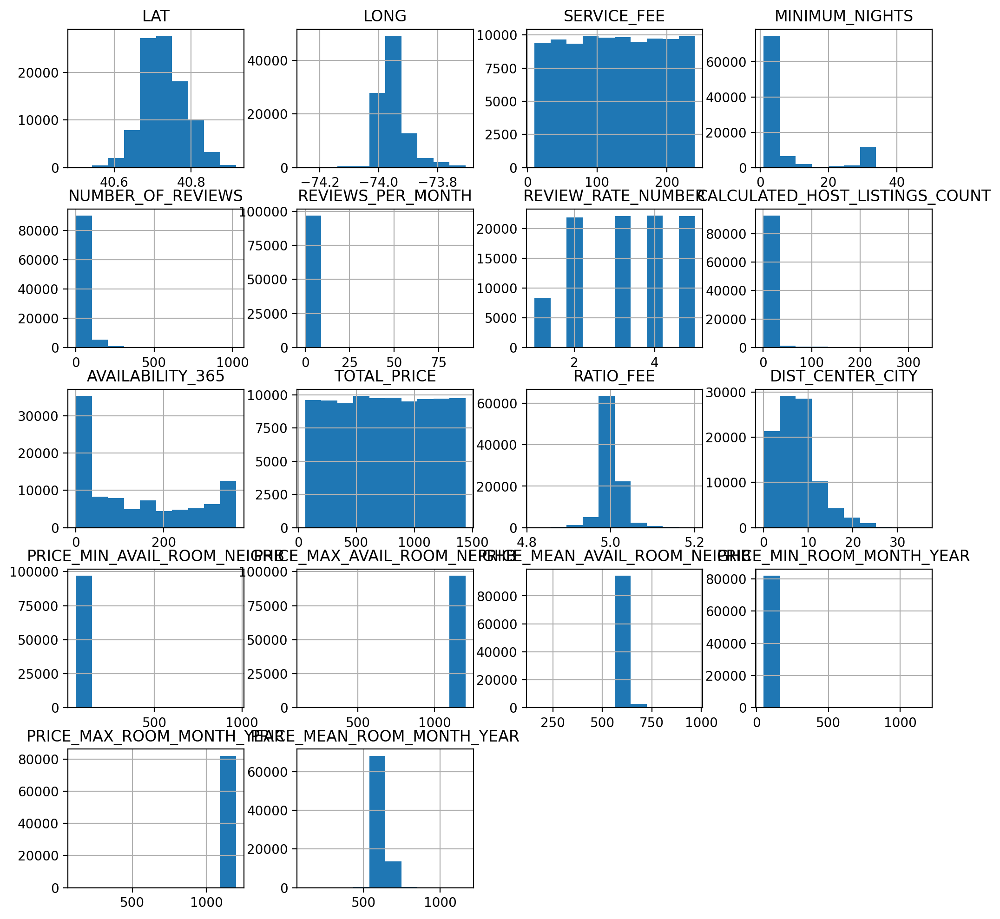

In [107]:
X.hist(figsize=(12, 12))

#### Valores ausentes

In [108]:
miss = ( 1 - X[cols_num].describe().T[['count']] / len(X) ) * 100
miss

,count
LAT,0.00
LONG,0.00
SERVICE_FEE,0.26
MINIMUM_NIGHTS,0.00
NUMBER_OF_REVIEWS,0.13
REVIEWS_PER_MONTH,0.00
REVIEW_RATE_NUMBER,0.28
CALCULATED_HOST_LISTINGS_COUNT,0.30
AVAILABILITY_365,0.00
TOTAL_PRICE,0.46


#### Imputación

In [109]:
from sklearn.impute import SimpleImputer

im = SimpleImputer( strategy='mean' )
im.fit( X[cols_num] )

SimpleImputer()

In [110]:
X.isna().sum()

LAT                                   0
LONG                                  0
SERVICE_FEE                         255
MINIMUM_NIGHTS                        0
NUMBER_OF_REVIEWS                   126
REVIEWS_PER_MONTH                     0
REVIEW_RATE_NUMBER                  273
CALCULATED_HOST_LISTINGS_COUNT      290
AVAILABILITY_365                      0
TOTAL_PRICE                         450
RATIO_FEE                           450
DIST_CENTER_CITY                      0
PRICE_MIN_AVAIL_ROOM_NEIGHB          15
PRICE_MAX_AVAIL_ROOM_NEIGHB          15
PRICE_MEAN_AVAIL_ROOM_NEIGHB         15
PRICE_MIN_ROOM_MONTH_YEAR         14560
PRICE_MAX_ROOM_MONTH_YEAR         14560
PRICE_MEAN_ROOM_MONTH_YEAR        14560
dtype: int64

In [111]:
X[cols_num] = im.transform( X[cols_num] )

In [112]:
X.isna().sum()

LAT                               0
LONG                              0
SERVICE_FEE                       0
MINIMUM_NIGHTS                    0
NUMBER_OF_REVIEWS                 0
REVIEWS_PER_MONTH                 0
REVIEW_RATE_NUMBER                0
CALCULATED_HOST_LISTINGS_COUNT    0
AVAILABILITY_365                  0
TOTAL_PRICE                       0
RATIO_FEE                         0
DIST_CENTER_CITY                  0
PRICE_MIN_AVAIL_ROOM_NEIGHB       0
PRICE_MAX_AVAIL_ROOM_NEIGHB       0
PRICE_MEAN_AVAIL_ROOM_NEIGHB      0
PRICE_MIN_ROOM_MONTH_YEAR         0
PRICE_MAX_ROOM_MONTH_YEAR         0
PRICE_MEAN_ROOM_MONTH_YEAR        0
dtype: int64

In [113]:
X.shape, X.dropna().shape, X.dropna().shape[0] / X.shape[0]

((97034, 18), (97034, 18), 1.0)

#### Distribución no alterada

In [114]:
airbnb.dropna().shape, X.shape

((1, 41), (97034, 18))

In [115]:
from scipy.stats import ks_2samp

df_ks = pd.DataFrame(
    map(
        lambda x: ( x, ks_2samp( airbnb[x].dropna(), X[x] ).statistic ),
        cols_num
    ),
    columns=['var', 'ks']
)

> __Si el factor $ks > 0.1$, la variable se considera como "ROTA__

In [116]:
df_ks

,var,ks
0,LAT,0.00
1,LONG,0.00
2,SERVICE_FEE,0.00
3,MINIMUM_NIGHTS,0.00
4,NUMBER_OF_REVIEWS,0.00
5,REVIEWS_PER_MONTH,0.00
6,REVIEW_RATE_NUMBER,0.00
7,CALCULATED_HOST_LISTINGS_COUNT,0.00
8,AVAILABILITY_365,0.00
9,TOTAL_PRICE,0.00


In [117]:
df_ks.loc[ df_ks['ks'] > 0.1 ]['var'].to_list()

['PRICE_MIN_ROOM_MONTH_YEAR', 'PRICE_MAX_ROOM_MONTH_YEAR']

In [118]:
# variables rotas
var_broken = df_ks.loc[ df_ks['ks'] > 0.1 ]['var'].to_list()

# eliminamos las variables rotas
cols_num = [ _ for _ in cols_num if _ not in var_broken ]

print("Num. cols: ", len(cols_num))
display(cols_num)

Num. cols:  16


['LAT',
 'LONG',
 'SERVICE_FEE',
 'MINIMUM_NIGHTS',
 'NUMBER_OF_REVIEWS',
 'REVIEWS_PER_MONTH',
 'REVIEW_RATE_NUMBER',
 'CALCULATED_HOST_LISTINGS_COUNT',
 'AVAILABILITY_365',
 'TOTAL_PRICE',
 'RATIO_FEE',
 'DIST_CENTER_CITY',
 'PRICE_MIN_AVAIL_ROOM_NEIGHB',
 'PRICE_MAX_AVAIL_ROOM_NEIGHB',
 'PRICE_MEAN_AVAIL_ROOM_NEIGHB',
 'PRICE_MEAN_ROOM_MONTH_YEAR']

#### Varianza

In [119]:
from sklearn.feature_selection import VarianceThreshold

variance_threshold = VarianceThreshold(0.5)
variance_threshold.fit( X[cols_num] )

VarianceThreshold(threshold=0.5)

In [120]:
wo_variance = [ v for v,u in zip(cols_num, variance_threshold.get_support()) if not(u)]
print("Columnas sin varianza: ", len(wo_variance))
display(wo_variance)

Columnas sin varianza:  3


['LAT', 'LONG', 'RATIO_FEE']

array([[<Axes: title={'center': 'LAT'}>,
        <Axes: title={'center': 'LONG'}>],
       [<Axes: title={'center': 'RATIO_FEE'}>, <Axes: >]], dtype=object)

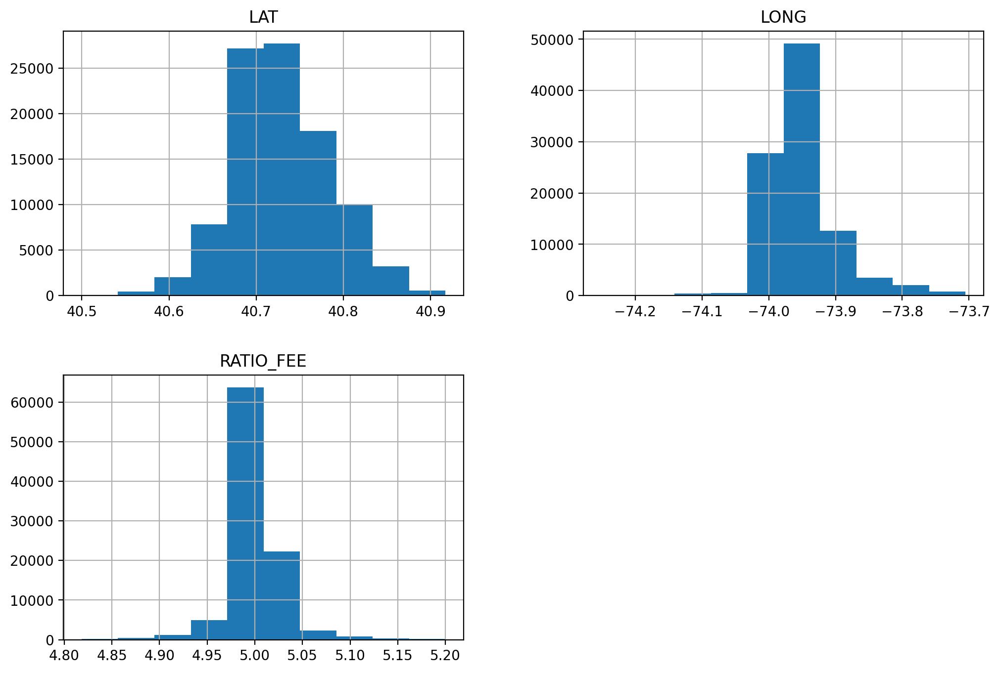

In [121]:
airbnb[wo_variance].hist(figsize=(12, 8))

Eliminamos identificadores de columnas

In [122]:
cols_num = [ _ for _ in cols_num if _ not in wo_variance ]
cols_num

['SERVICE_FEE',
 'MINIMUM_NIGHTS',
 'NUMBER_OF_REVIEWS',
 'REVIEWS_PER_MONTH',
 'REVIEW_RATE_NUMBER',
 'CALCULATED_HOST_LISTINGS_COUNT',
 'AVAILABILITY_365',
 'TOTAL_PRICE',
 'DIST_CENTER_CITY',
 'PRICE_MIN_AVAIL_ROOM_NEIGHB',
 'PRICE_MAX_AVAIL_ROOM_NEIGHB',
 'PRICE_MEAN_AVAIL_ROOM_NEIGHB',
 'PRICE_MEAN_ROOM_MONTH_YEAR']

In [123]:
len(cols_num)

13

#### Extremos

In [124]:
X[cols_num].describe( percentiles=[.01, .99] ).T.reset_index()

,index,count,mean,std,min,1%,50%,99%,max
0,SERVICE_FEE,"97,034.00",125.18,66.24,10.00,12.00,125.00,238.00,240.00
1,MINIMUM_NIGHTS,"97,034.00",6.73,9.60,1.00,1.00,3.00,30.00,48.00
2,NUMBER_OF_REVIEWS,"97,034.00",27.33,49.00,0.00,0.00,7.00,230.00,"1,024.00"
3,REVIEWS_PER_MONTH,"97,034.00",1.19,1.70,0.00,0.00,0.51,6.84,90.00
4,REVIEW_RATE_NUMBER,"97,034.00",3.29,1.28,1.00,1.00,3.00,5.00,5.00
5,CALCULATED_HOST_LISTINGS_COUNT,"97,034.00",8.02,32.55,1.00,1.00,1.00,208.00,332.00
6,AVAILABILITY_365,"97,034.00",133.98,129.76,0.00,0.00,90.00,365.00,365.00
7,TOTAL_PRICE,"97,034.00",751.17,397.06,60.00,73.00,751.17,"1,426.00","1,440.00"
8,DIST_CENTER_CITY,"97,034.00",7.42,4.69,0.03,0.52,6.77,22.56,35.94
9,PRICE_MIN_AVAIL_ROOM_NEIGHB,"97,034.00",50.53,7.65,50.00,50.00,50.00,61.00,967.00


In [125]:
from plotly.subplots import make_subplots
import plotly.graph_objects as go

vars = cols_num
fig = make_subplots(rows=1, cols=len(vars))
for i, var in enumerate(vars):
    fig.add_trace(
        go.Box(y=X[var],
        name=var),
        row=1, col=i+1
    )
fig.show()
#fig.update_traces(boxpoints='all', jitter=.3)

#### Análisis Bivariado

In [126]:
X[ cols_num ].corr()

,SERVICE_FEE,MINIMUM_NIGHTS,NUMBER_OF_REVIEWS,REVIEWS_PER_MONTH,REVIEW_RATE_NUMBER,CALCULATED_HOST_LISTINGS_COUNT,AVAILABILITY_365,TOTAL_PRICE,DIST_CENTER_CITY,PRICE_MIN_AVAIL_ROOM_NEIGHB,PRICE_MAX_AVAIL_ROOM_NEIGHB,PRICE_MEAN_AVAIL_ROOM_NEIGHB,PRICE_MEAN_ROOM_MONTH_YEAR
SERVICE_FEE,1.00,-0.00,0.01,0.01,-0.01,-0.00,-0.00,1.00,0.00,0.01,0.00,0.03,0.07
MINIMUM_NIGHTS,-0.00,1.00,-0.12,-0.23,0.02,0.27,0.16,-0.00,-0.13,-0.02,0.02,-0.01,-0.00
NUMBER_OF_REVIEWS,0.01,-0.12,1.00,0.62,-0.02,-0.08,0.10,0.01,0.08,-0.00,0.00,0.01,0.00
REVIEWS_PER_MONTH,0.01,-0.23,0.62,1.00,0.03,-0.04,0.10,0.01,0.11,-0.00,-0.00,0.01,0.00
REVIEW_RATE_NUMBER,-0.01,0.02,-0.02,0.03,1.00,0.02,0.00,-0.01,0.01,0.00,-0.01,-0.00,-0.00
CALCULATED_HOST_LISTINGS_COUNT,-0.00,0.27,-0.08,-0.04,0.02,1.00,0.17,-0.00,-0.13,-0.01,0.01,-0.00,-0.00
AVAILABILITY_365,-0.00,0.16,0.10,0.10,0.00,0.17,1.00,-0.00,0.08,-0.03,0.02,-0.08,-0.01
TOTAL_PRICE,1.00,-0.00,0.01,0.01,-0.01,-0.00,-0.00,1.00,0.00,0.01,0.00,0.03,0.07
DIST_CENTER_CITY,0.00,-0.13,0.08,0.11,0.01,-0.13,0.08,0.00,1.00,0.05,-0.06,0.10,0.02
PRICE_MIN_AVAIL_ROOM_NEIGHB,0.01,-0.02,-0.00,-0.00,0.00,-0.01,-0.03,0.01,0.05,1.00,-0.65,0.16,0.03


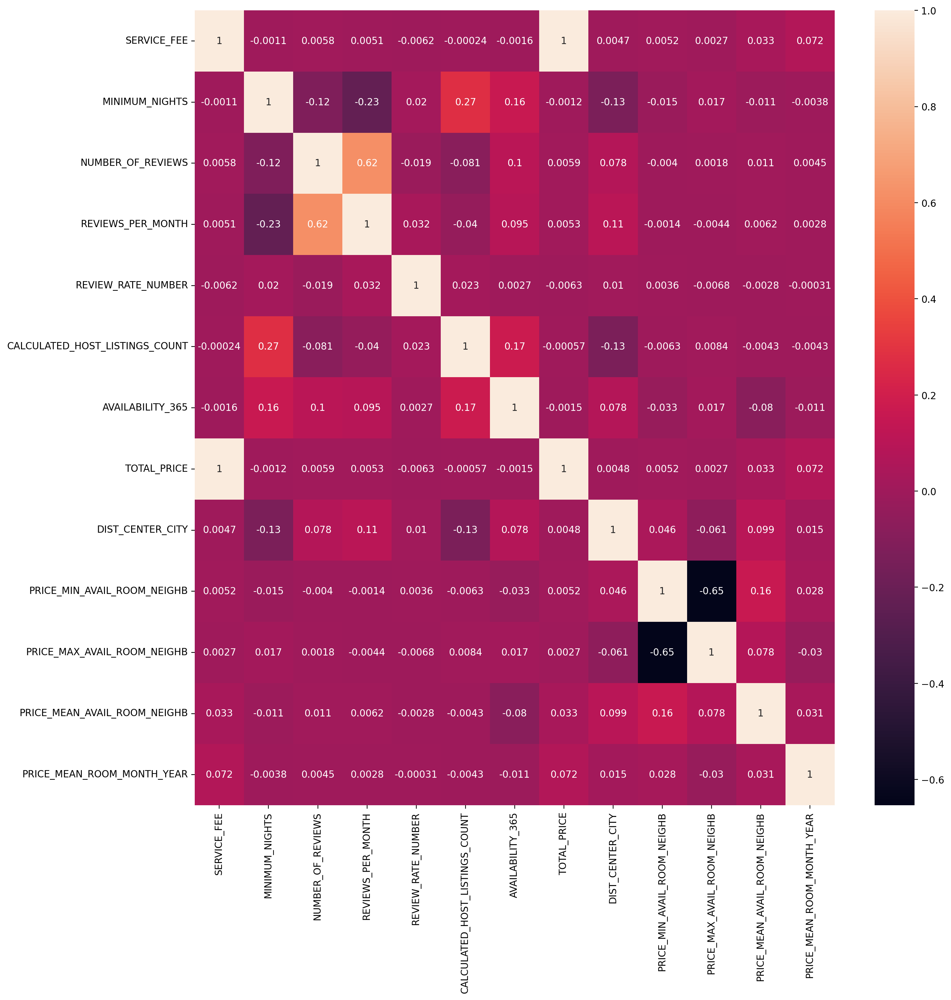

In [127]:
corr_df = X[ cols_num ].corr()
plt.figure( figsize=(15, 15) )
sns.heatmap( corr_df, annot=True )
plt.show()

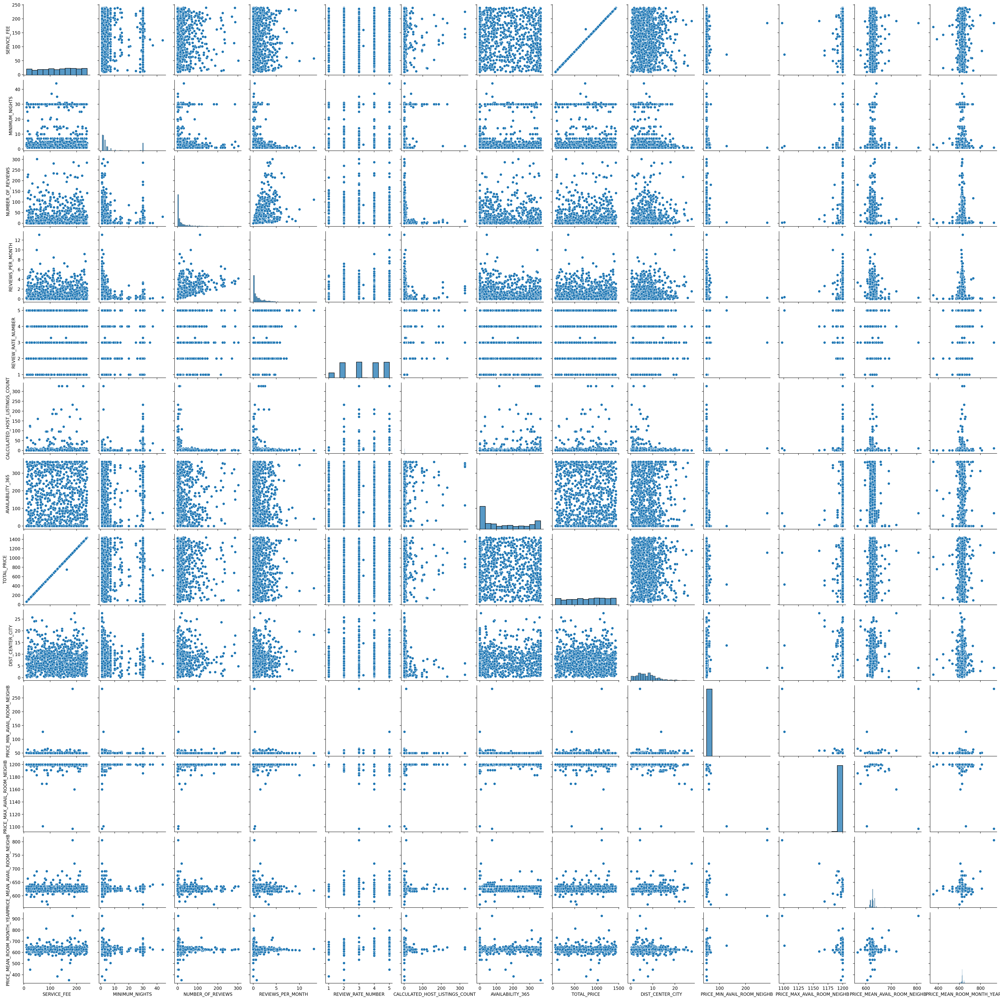

In [128]:
sns.pairplot( X[cols_num].sample(1000) )

#### Multicolinealidad

In [129]:
vc = VarClusHi( df=X[cols_num], feat_list=cols_num )
vc.varclus() # train cluster

In [130]:
rs = vc.rsquare
rs = rs.sort_values(by=['Cluster', 'RS_Ratio'],
                    ascending=[1, 1]).reset_index(drop=True)
rs['id'] = rs.groupby('Cluster').cumcount()+1
rs

,Cluster,Variable,RS_Own,RS_NC,RS_Ratio,id
0,0,TOTAL_PRICE,0.99,0.00,0.01,1
1,0,SERVICE_FEE,0.99,0.00,0.01,2
2,0,PRICE_MEAN_ROOM_MONTH_YEAR,0.02,0.00,0.98,3
3,0,REVIEW_RATE_NUMBER,0.00,0.00,1.00,4
4,1,NUMBER_OF_REVIEWS,0.81,0.02,0.20,1
5,1,REVIEWS_PER_MONTH,0.81,0.03,0.20,2
6,2,PRICE_MAX_AVAIL_ROOM_NEIGHB,0.83,0.00,0.17,1
7,2,PRICE_MIN_AVAIL_ROOM_NEIGHB,0.83,0.02,0.18,2
8,3,CALCULATED_HOST_LISTINGS_COUNT,0.54,0.01,0.46,1
9,3,MINIMUM_NIGHTS,0.54,0.04,0.47,2


In [131]:
rs.loc[ rs['id'] == 1 ]

,Cluster,Variable,RS_Own,RS_NC,RS_Ratio,id
0,0,TOTAL_PRICE,0.99,0.00,0.01,1
4,1,NUMBER_OF_REVIEWS,0.81,0.02,0.20,1
6,2,PRICE_MAX_AVAIL_ROOM_NEIGHB,0.83,0.00,0.17,1
8,3,CALCULATED_HOST_LISTINGS_COUNT,0.54,0.01,0.46,1
11,4,PRICE_MEAN_AVAIL_ROOM_NEIGHB,0.54,0.00,0.46,1


In [132]:
cols_num = rs.loc[ rs['id'] == 1 ]['Variable'].tolist()
cols_num

['TOTAL_PRICE',
 'NUMBER_OF_REVIEWS',
 'PRICE_MAX_AVAIL_ROOM_NEIGHB',
 'CALCULATED_HOST_LISTINGS_COUNT',
 'PRICE_MEAN_AVAIL_ROOM_NEIGHB']

array([[<Axes: title={'center': 'TOTAL_PRICE'}>,
        <Axes: title={'center': 'NUMBER_OF_REVIEWS'}>],
       [<Axes: title={'center': 'PRICE_MAX_AVAIL_ROOM_NEIGHB'}>,
        <Axes: title={'center': 'CALCULATED_HOST_LISTINGS_COUNT'}>],
       [<Axes: title={'center': 'PRICE_MEAN_AVAIL_ROOM_NEIGHB'}>,
        <Axes: >]], dtype=object)

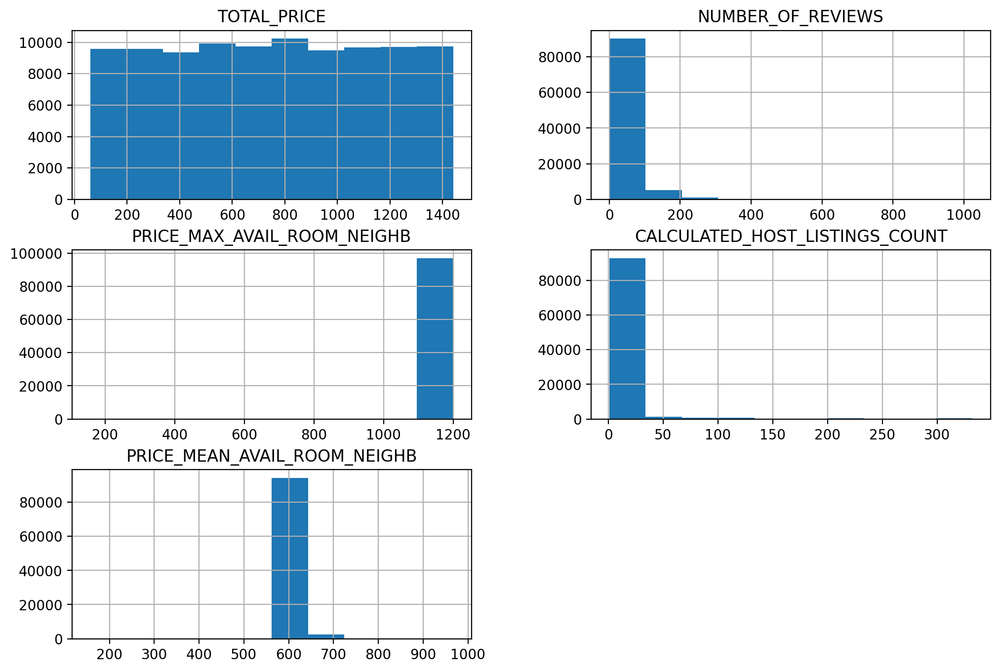

In [133]:
X[cols_num].hist(figsize=(12, 8))

In [134]:
import gc

del X
gc.collect()

960

## Binarias

In [135]:
airbnb[cols_bin].head()

,INSTANT_BOOKABLE,HOST_IDENTITY_VERIFIED
0,False,unconfirmed
1,False,verified
2,True,NaN
3,True,unconfirmed
4,False,verified


In [136]:
airbnb['INSTANT_BOOKABLE'].value_counts()

INSTANT_BOOKABLE
False    48735
True     48226
Name: count, dtype: int64

In [137]:
airbnb['INSTANT_BOOKABLE'].value_counts()

INSTANT_BOOKABLE
False    48735
True     48226
Name: count, dtype: int64

In [138]:
airbnb.shape

(97034, 41)

In [139]:
airbnb = airbnb[~(airbnb['INSTANT_BOOKABLE'].isna())]
airbnb = airbnb[~(airbnb['HOST_IDENTITY_VERIFIED'].isna())]

In [140]:
airbnb.shape

(96717, 41)

# TAD 

In [141]:
airbnb[ um + cols_num + cols_bin + cols_tgt].head()

,ID,TOTAL_PRICE,NUMBER_OF_REVIEWS,PRICE_MAX_AVAIL_ROOM_NEIGHB,CALCULATED_HOST_LISTINGS_COUNT,PRICE_MEAN_AVAIL_ROOM_NEIGHB,INSTANT_BOOKABLE,HOST_IDENTITY_VERIFIED,PRICE,AVAILABILITY_365_CAT
0,1001254,"1,159.00",9.00,"1,200.00",6.00,618.94,False,unconfirmed,966.00,HIGH
1,1002102,170.00,45.00,"1,200.00",2.00,626.30,False,verified,142.00,HIGH
3,1002755,442.00,270.00,"1,200.00",1.00,634.78,True,unconfirmed,368.00,HIGH
4,1003689,245.00,9.00,"1,200.00",1.00,626.30,False,verified,204.00,HIGH
6,1005202,"1,272.00",49.00,"1,200.00",1.00,618.94,False,unconfirmed,"1,060.00",HIGH


In [142]:
airbnb[ um + cols_num + cols_bin + cols_tgt].merge(df_dummy, on=um, how='left')

,ID,TOTAL_PRICE,NUMBER_OF_REVIEWS,PRICE_MAX_AVAIL_ROOM_NEIGHB,CALCULATED_HOST_LISTINGS_COUNT,PRICE_MEAN_AVAIL_ROOM_NEIGHB,INSTANT_BOOKABLE,HOST_IDENTITY_VERIFIED,PRICE,AVAILABILITY_365_CAT,n_NEIGHBOURHOOD_GROUP_Brooklyn,n_NEIGHBOURHOOD_GROUP_Manhattan,n_NEIGHBOURHOOD_Bedford-Stuyvesant,n_NEIGHBOURHOOD_CAT_PEQUEÑAS,n_NEIGHBOURHOOD_Harlem,n_CANCELLATION_POLICY_flexible,n_CANCELLATION_POLICY_moderate,n_ROOM_TYPE_Entire home/apt,n_CONSTRUCTION_YEAR_2005.0,n_CONSTRUCTION_YEAR_2006.0,n_CONSTRUCTION_YEAR_2008.0,n_CONSTRUCTION_YEAR_2009.0,n_CONSTRUCTION_YEAR_2010.0,n_CONSTRUCTION_YEAR_2014.0,n_CONSTRUCTION_YEAR_2019.0,n_CONSTRUCTION_YEAR_2020.0,n_HOST_IDENTITY_VERIFIED_2_0,n_LAST_REVIEW_YEAR_2017.0,n_LAST_REVIEW_YEAR_2018.0,n_LAST_REVIEW_YEAR_2019.0,n_LAST_REVIEW_YEAR_2021.0,n_LAST_REVIEW_YEAR_2022.0,n_LAST_REVIEW_YEAR_CAT_PEQUEÑAS,n_LAST_REVIEW_MONTH_1.0,n_LAST_REVIEW_MONTH_12.0,n_LAST_REVIEW_MONTH_2.0,n_LAST_REVIEW_MONTH_5.0,n_LAST_REVIEW_MONTH_6.0,n_LAST_REVIEW_MONTH_7.0,n_LAST_REVIEW_MONTH_CAT_PEQUEÑAS,n_RATIO_FEE_CAT_HIGH
0,1001254,"1,159.00",9.00,"1,200.00",6.00,618.94,False,unconfirmed,966.00,HIGH,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,1,0
1,1002102,170.00,45.00,"1,200.00",2.00,626.30,False,verified,142.00,HIGH,0,1,0,1,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,1
2,1002755,442.00,270.00,"1,200.00",1.00,634.78,True,unconfirmed,368.00,HIGH,1,0,0,1,0,0,1,1,1,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0
3,1003689,245.00,9.00,"1,200.00",1.00,626.30,False,verified,204.00,HIGH,0,1,0,1,0,0,1,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0
4,1005202,"1,272.00",49.00,"1,200.00",1.00,618.94,False,unconfirmed,"1,060.00",HIGH,1,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
96712,57365208,NaN,12.00,"1,200.00",1.00,629.00,True,unconfirmed,696.00,LOW,1,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,0,1,0
96713,57365760,NaN,19.00,"1,200.00",2.00,629.00,False,verified,909.00,LOW,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0
96714,57366313,NaN,50.00,"1,200.00",2.00,634.78,True,verified,387.00,HIGH,1,0,1,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0
96715,57366865,NaN,0.00,"1,200.00",1.00,625.89,True,unconfirmed,848.00,LOW,0,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [143]:
tad = airbnb[ um + cols_num + cols_bin + cols_tgt].merge(df_dummy, on=um, how='left')
tad.head()

,ID,TOTAL_PRICE,NUMBER_OF_REVIEWS,PRICE_MAX_AVAIL_ROOM_NEIGHB,CALCULATED_HOST_LISTINGS_COUNT,PRICE_MEAN_AVAIL_ROOM_NEIGHB,INSTANT_BOOKABLE,HOST_IDENTITY_VERIFIED,PRICE,AVAILABILITY_365_CAT,n_NEIGHBOURHOOD_GROUP_Brooklyn,n_NEIGHBOURHOOD_GROUP_Manhattan,n_NEIGHBOURHOOD_Bedford-Stuyvesant,n_NEIGHBOURHOOD_CAT_PEQUEÑAS,n_NEIGHBOURHOOD_Harlem,n_CANCELLATION_POLICY_flexible,n_CANCELLATION_POLICY_moderate,n_ROOM_TYPE_Entire home/apt,n_CONSTRUCTION_YEAR_2005.0,n_CONSTRUCTION_YEAR_2006.0,n_CONSTRUCTION_YEAR_2008.0,n_CONSTRUCTION_YEAR_2009.0,n_CONSTRUCTION_YEAR_2010.0,n_CONSTRUCTION_YEAR_2014.0,n_CONSTRUCTION_YEAR_2019.0,n_CONSTRUCTION_YEAR_2020.0,n_HOST_IDENTITY_VERIFIED_2_0,n_LAST_REVIEW_YEAR_2017.0,n_LAST_REVIEW_YEAR_2018.0,n_LAST_REVIEW_YEAR_2019.0,n_LAST_REVIEW_YEAR_2021.0,n_LAST_REVIEW_YEAR_2022.0,n_LAST_REVIEW_YEAR_CAT_PEQUEÑAS,n_LAST_REVIEW_MONTH_1.0,n_LAST_REVIEW_MONTH_12.0,n_LAST_REVIEW_MONTH_2.0,n_LAST_REVIEW_MONTH_5.0,n_LAST_REVIEW_MONTH_6.0,n_LAST_REVIEW_MONTH_7.0,n_LAST_REVIEW_MONTH_CAT_PEQUEÑAS,n_RATIO_FEE_CAT_HIGH
0,1001254,"1,159.00",9.00,"1,200.00",6.00,618.94,False,unconfirmed,966.00,HIGH,1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,1,0,0,0,0,0,0,0,0,1,0
1,1002102,170.00,45.00,"1,200.00",2.00,626.30,False,verified,142.00,HIGH,0,1,0,1,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,1,0,0,0,1
2,1002755,442.00,270.00,"1,200.00",1.00,634.78,True,unconfirmed,368.00,HIGH,1,0,0,1,0,0,1,1,1,0,0,0,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0
3,1003689,245.00,9.00,"1,200.00",1.00,626.30,False,verified,204.00,HIGH,0,1,0,1,0,0,1,1,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0
4,1005202,"1,272.00",49.00,"1,200.00",1.00,618.94,False,unconfirmed,"1,060.00",HIGH,1,0,1,0,0,0,1,0,0,0,0,1,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,0


In [144]:
tad.to_parquet('../data/Airbnb/tad_airbnb.parquet')